In [1]:
import os
import zarr
import random
import json
import warnings
import numpy as np
import pandas as pd
import torch.nn as nn
from pathlib import Path
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Dataset
from collections import defaultdict
import sys
import torch
import torchvision.transforms.functional as F
import random

warnings.filterwarnings("ignore")
sys.path.append("./src/")

from src.config import CFG
from src.dataloader import (
    read_zarr,
    read_info_json,
    scale_coordinates,
    create_dataset,
    create_segmentation_map,
    EziiDataset,
    drop_padding,
)
from src.network import UNet_2D, aug
from src.utils import save_images
from src.metric import score, create_cls_pos, create_cls_pos_sikii, create_df
from metric import visualize_epoch_results

In [2]:
train_dataset = EziiDataset(
    exp_names=CFG.train_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.train_zarr_types,
    train=True,
)

valid_dataset = EziiDataset(
    exp_names=CFG.valid_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.valid_zarr_types,
    train=True,
)

from tqdm import tqdm

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, drop_last=True)
train_nshuffle_loader = DataLoader(train_dataset, batch_size=1, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False)

for data in tqdm(train_dataset):
    normalized_tomogram = data["normalized_tomogram"]
    segmentation_map = data["segmentation_map"]
    break

# normalized_tomogram =
normalized_tomogram.shape[0]

[('TS_5_4', 'denoised'), ('TS_5_4', 'ctfdeconvolved'), ('TS_5_4', 'wbp'), ('TS_5_4', 'isonetcorrected'), ('TS_73_6', 'denoised'), ('TS_73_6', 'ctfdeconvolved'), ('TS_73_6', 'wbp'), ('TS_73_6', 'isonetcorrected'), ('TS_99_9', 'denoised'), ('TS_99_9', 'ctfdeconvolved'), ('TS_99_9', 'wbp'), ('TS_99_9', 'isonetcorrected'), ('TS_6_4', 'denoised'), ('TS_6_4', 'ctfdeconvolved'), ('TS_6_4', 'wbp'), ('TS_6_4', 'isonetcorrected'), ('TS_69_2', 'denoised'), ('TS_69_2', 'ctfdeconvolved'), ('TS_69_2', 'wbp'), ('TS_69_2', 'isonetcorrected')]
[('TS_86_3', 'denoised'), ('TS_6_6', 'denoised')]


  0%|          | 0/20 [00:02<?, ?it/s]


184

In [3]:
# torchのpadding用の関数
# torch.Size([4, 1, 158, 158]) -> torch.Size([4, 1, 160, 160])


class PadToSize(nn.Module):
    def __init__(self, resolution):
        super().__init__()
        if resolution == "0":
            self.size = 640
        elif resolution == "1":
            self.size = 320
        elif resolution == "2":
            self.size = 160

    def forward(self, x):
        return F.pad(x, (0, 0, self.size - x.shape[-1], self.size - x.shape[-2]))


# test
pad = PadToSize(CFG.resolution)
test_input = torch.randn((4, 1, 158, 158))
print(test_input.shape)
print(pad(test_input).shape)

torch.Size([4, 1, 158, 158])
torch.Size([4, 1, 640, 640])


In [4]:
model = UNet_2D().to("cuda")
model.eval()

UNet_2D(
  (model): Unet(
    (encoder): ResNetEncoder(
      (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (r

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

# サンプルデータ
num_classes = len(CFG.particles_name)  # クラス数
colors = plt.cm.tab10(
    np.arange(len(CFG.particles_name))
)  # "tab10" カラーマップから色を取得

# ListedColormap を作成
class_colormap = ListedColormap(colors)


# カラーバー付きプロット
def plot_with_colormap(data, title, original_tomogram):
    masked_data = np.ma.masked_where(data <= 0, data)  # クラス0をマスク
    plt.imshow(original_tomogram, cmap="gray")
    im = plt.imshow(masked_data, cmap=class_colormap)
    plt.title(title)
    plt.axis("off")
    return im

In [6]:
class SegmentationLoss(nn.Module):
    def __init__(self, criterion):
        super().__init__()
        self.softmax = nn.Softmax(dim=1)
        self.criterion = criterion

    def forward(self, output, target):
        # output: (batch, cls, 160, 160)
        # target: (batch, 160, 160)

        # output, (batch, 160, 160, cls) -> (batch, 160, 160, cls)
        output = output.permute(0, 2, 3, 1)
        output = output.reshape(-1, output.shape[-1])  # (batch*160*160, cls)

        # target, (batch, 160, 160) -> (batch*160*160)
        target = target.reshape(-1)

        loss = self.criterion(output, target)
        return loss

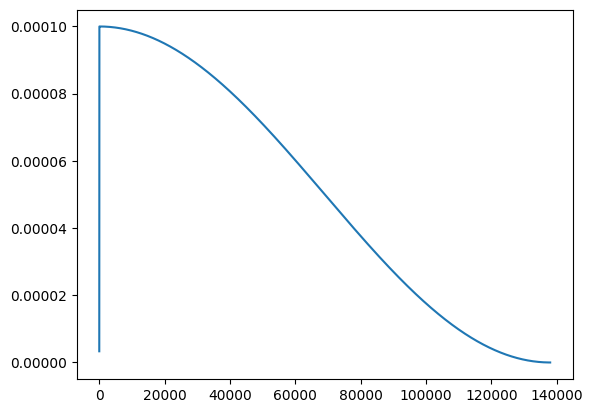

In [7]:
from transformers import get_cosine_schedule_with_warmup

n_epochs = 300
batch_size = 8

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)
criterion = nn.CrossEntropyLoss(
    weight=torch.tensor([2.0, 32, 32, 32, 32, 32, 32]).to("cuda")
)
scheduler = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=n_epochs // 10,
    num_training_steps=n_epochs
    * len(train_loader)
    * (normalized_tomogram.shape[0] // batch_size),
    # * batch_size,
)
seg_loss = SegmentationLoss(criterion)
padf = PadToSize(CFG.resolution)

# schedulerのlr推移の可視化
lr_list = []

for epoch in range(
    n_epochs * len(train_loader) * (normalized_tomogram.shape[0] // batch_size)
):
    scheduler.step()
    lr_list.append(optimizer.param_groups[0]["lr"])

plt.plot(lr_list)

# del scheduler, lr_list, optimizer

optimizer = torch.optim.AdamW(model.parameters(), lr=5e-4)

scheduler = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=n_epochs // 10,
    num_training_steps=n_epochs
    * len(train_loader)
    * (normalized_tomogram.shape[0] // batch_size),
)

Train-Epoch: 0, Loss: 0.36096410155296327: 100%|██████████| 460/460 [04:14<00:00,  1.81it/s]
Train-nshuffle-Epoch: 0, Loss: 0.5431905213976279: 100%|██████████| 3680/3680 [02:52<00:00, 21.39it/s] 


EPOCH: 0, TRAIN_SCORE: 0.08805296356876413, TRAIN_SCORE_LIST: [0.1250542955924465, 0.05531896622063, 0.07460237033681623, 0.10945611224512113, 0.07583307344880683]


Valid-Epoch: 0, Loss: 0.7307202949861834: 100%|██████████| 368/368 [00:17<00:00, 20.58it/s]


EPOCH: 0, VALID_SCORE: 0.17096739472198733, VALID_SCORE_LIST: [0.18337917390664935, 0.1585556155373253]


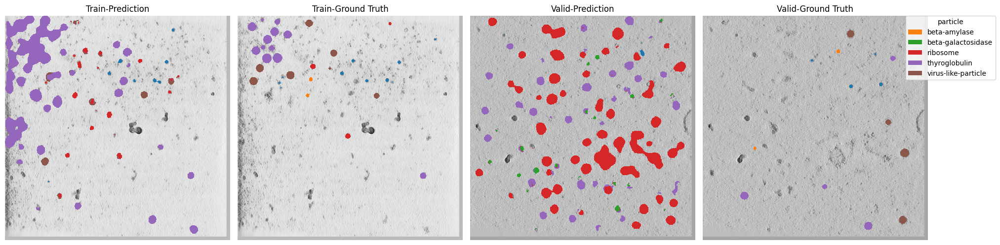

Train-Epoch: 1, Loss: 0.11183666477546744: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 1, Loss: 0.5680829756636977: 100%|██████████| 3680/3680 [02:40<00:00, 22.99it/s] 


EPOCH: 1, TRAIN_SCORE: 0.010290107438115554, TRAIN_SCORE_LIST: [0.0032825902664942066, 0.01323750330194067, 0.013563107067758722, 0.012150514541714267, 0.009216822012669906]


Valid-Epoch: 1, Loss: 1.012170073916976: 100%|██████████| 368/368 [00:17<00:00, 21.04it/s]  


EPOCH: 1, VALID_SCORE: 0.06382818090834719, VALID_SCORE_LIST: [0.08138587645257027, 0.04627048536412411]


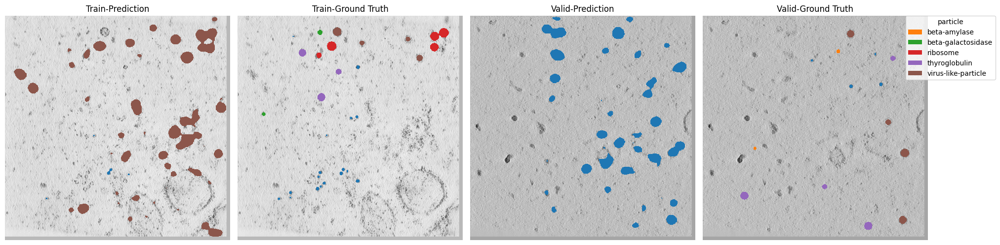

Train-Epoch: 2, Loss: 0.05850771419784945: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 2, Loss: 0.8999206056175709: 100%|██████████| 3680/3680 [02:41<00:00, 22.77it/s]


EPOCH: 2, TRAIN_SCORE: 0.002830950918472022, TRAIN_SCORE_LIST: [0.0016046392953745685, 0.004422104041810765, 0.0019568813769378066, 0.003342268095322285, 0.002828861782914684]


Valid-Epoch: 2, Loss: 1.4912172807983197: 100%|██████████| 368/368 [00:16<00:00, 21.77it/s] 


EPOCH: 2, VALID_SCORE: 0.010089161322776725, VALID_SCORE_LIST: [0.013666241074384073, 0.006512081571169379]


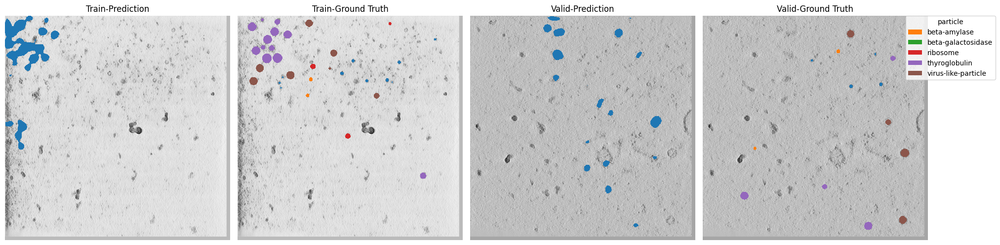

Train-Epoch: 3, Loss: 0.036454062797534076: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 3, Loss: 0.7835892759021669: 100%|██████████| 3680/3680 [02:38<00:00, 23.17it/s] 


EPOCH: 3, TRAIN_SCORE: 0.06622932753633007, TRAIN_SCORE_LIST: [0.07958168269863089, 0.053606698900685056, 0.06531984029436179, 0.0829178912035242, 0.04972052458444841]


Valid-Epoch: 3, Loss: 2.616575251451729: 100%|██████████| 368/368 [00:16<00:00, 22.06it/s]  


EPOCH: 3, VALID_SCORE: 0.062470440580463846, VALID_SCORE_LIST: [0.06566152195651755, 0.059279359204410145]


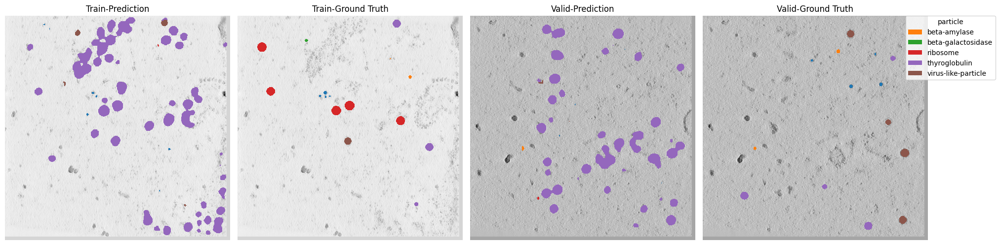

Train-nshuffle-Epoch: 4, Loss: 0.780354730360246: 100%|██████████| 3680/3680 [02:37<00:00, 23.38it/s]  


EPOCH: 4, TRAIN_SCORE: 0.02143195519505405, TRAIN_SCORE_LIST: [0.025163210856956362, 0.0311382512709039, 0.019784469337231297, 0.01348557656515742, 0.017588267945021267]


Valid-Epoch: 4, Loss: 2.22179041382578: 100%|██████████| 368/368 [00:16<00:00, 22.11it/s]   


EPOCH: 4, VALID_SCORE: 0.019755768209827326, VALID_SCORE_LIST: [0.03421120996945648, 0.005300326450198174]


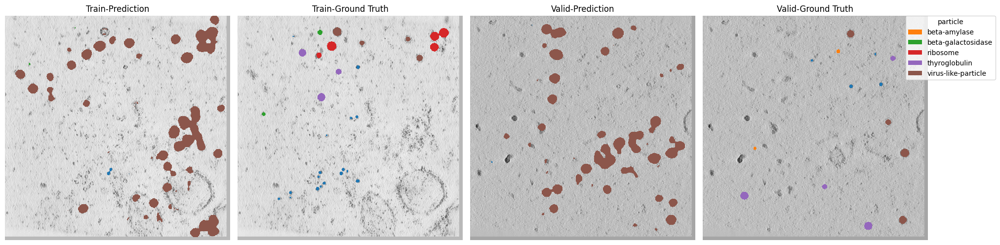

Train-Epoch: 5, Loss: 0.02417161367509676: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 5, Loss: 0.9311961663286401: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s]


EPOCH: 5, TRAIN_SCORE: 0.39713428508484555, TRAIN_SCORE_LIST: [0.3952599602591312, 0.34379010285292544, 0.4229596226337821, 0.39628854960364157, 0.42737319007474733]


Valid-Epoch: 5, Loss: 0.907098195080281: 100%|██████████| 368/368 [00:16<00:00, 22.44it/s]   


EPOCH: 5, VALID_SCORE: 0.34393986497151363, VALID_SCORE_LIST: [0.3776118512792415, 0.3102678786637857]


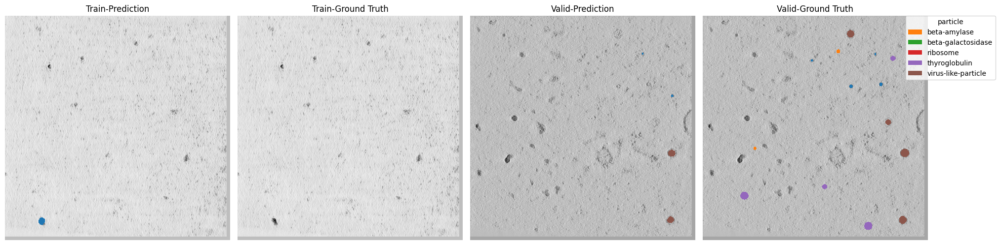

Train-Epoch: 6, Loss: 0.019353971148476652: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 6, Loss: 0.6302693938519912: 100%|██████████| 3680/3680 [02:38<00:00, 23.23it/s] 


EPOCH: 6, TRAIN_SCORE: 0.10281743206571095, TRAIN_SCORE_LIST: [0.10018802373146288, 0.11672598191439225, 0.10816120558236682, 0.10059059035373989, 0.08842135874659293]


Valid-Epoch: 6, Loss: 1.5639723131255818: 100%|██████████| 368/368 [00:16<00:00, 22.09it/s]  


EPOCH: 6, VALID_SCORE: 0.13136817105731452, VALID_SCORE_LIST: [0.13100719171377878, 0.13172915040085023]


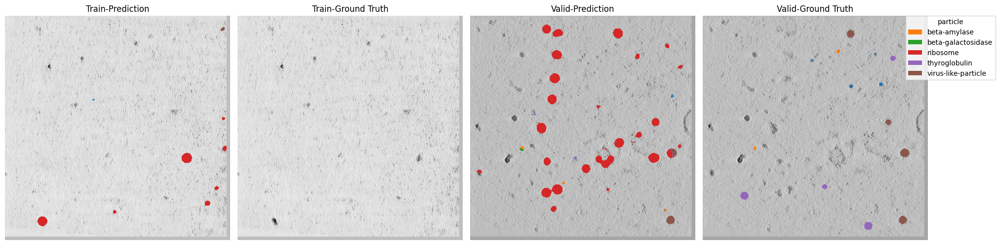

Train-Epoch: 7, Loss: 0.015765702671816817: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 7, Loss: 0.9476646453901001: 100%|██████████| 3680/3680 [02:39<00:00, 23.11it/s] 


EPOCH: 7, TRAIN_SCORE: 0.0906759782065215, TRAIN_SCORE_LIST: [0.07926715230507508, 0.08177024468754701, 0.12745872947656628, 0.09810851348901553, 0.06677525107440356]


Valid-Epoch: 7, Loss: 2.6592131416029745: 100%|██████████| 368/368 [00:16<00:00, 22.58it/s] 


EPOCH: 7, VALID_SCORE: 0.09107156683903259, VALID_SCORE_LIST: [0.07564925553011308, 0.10649387814795208]


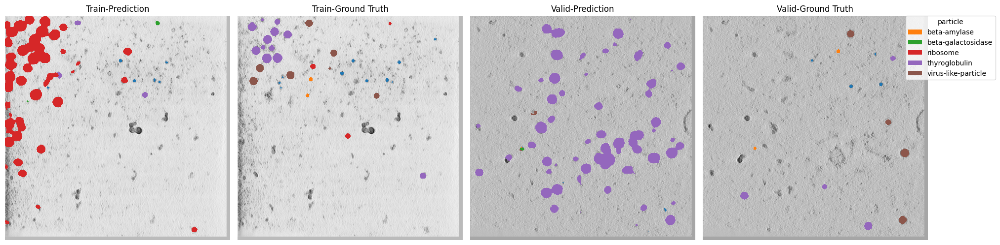

Train-Epoch: 8, Loss: 0.014710039482451975: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 8, Loss: 1.0116169954472465: 100%|██████████| 3680/3680 [02:37<00:00, 23.41it/s]  


EPOCH: 8, TRAIN_SCORE: 0.24743208224583788, TRAIN_SCORE_LIST: [0.237542720473027, 0.22229724041113347, 0.278664278761691, 0.2533007805822087, 0.24535539100112924]


Valid-Epoch: 8, Loss: 0.7132512713768768: 100%|██████████| 368/368 [00:16<00:00, 22.75it/s] 


EPOCH: 8, VALID_SCORE: 0.3153954492996255, VALID_SCORE_LIST: [0.3285720845410257, 0.30221881405822526]


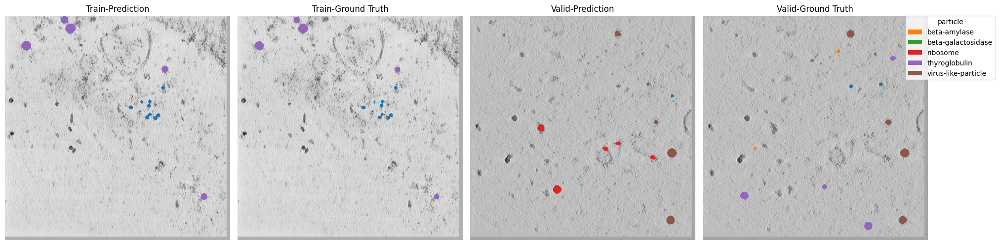

Train-nshuffle-Epoch: 9, Loss: 1.167700150738139: 100%|██████████| 3680/3680 [02:40<00:00, 22.91it/s]  


EPOCH: 9, TRAIN_SCORE: 0.07363995055179064, TRAIN_SCORE_LIST: [0.0634743043538089, 0.07439028289816575, 0.09608343319719413, 0.07260355539032616, 0.061648176919458224]


Valid-Epoch: 9, Loss: 2.6044840346262093: 100%|██████████| 368/368 [00:16<00:00, 22.75it/s] 


EPOCH: 9, VALID_SCORE: 0.06378864771197373, VALID_SCORE_LIST: [0.06056307665247861, 0.06701421877146886]


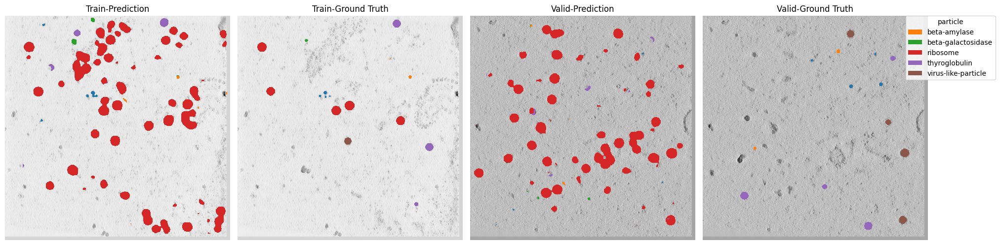

Train-Epoch: 10, Loss: 0.023946356031355327: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 10, Loss: 0.8419321859946965: 100%|██████████| 3680/3680 [02:38<00:00, 23.18it/s]


EPOCH: 10, TRAIN_SCORE: 0.09759817008994219, TRAIN_SCORE_LIST: [0.06808394161196897, 0.1242055619756488, 0.08247257436215853, 0.10971495888716895, 0.10351381361276572]


Valid-Epoch: 10, Loss: 1.9799348269816321: 100%|██████████| 368/368 [00:16<00:00, 22.26it/s] 


EPOCH: 10, VALID_SCORE: 0.1249143718015499, VALID_SCORE_LIST: [0.13103664292510478, 0.11879210067799503]


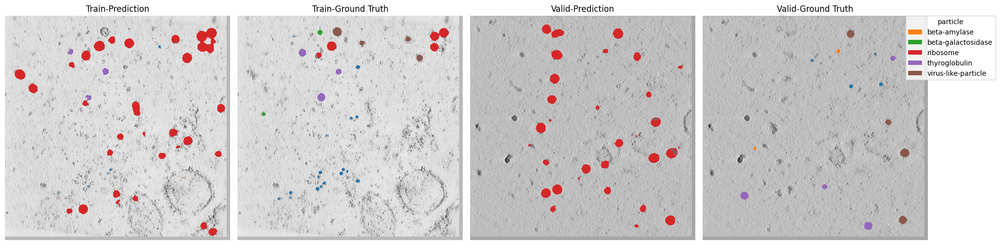

Train-Epoch: 11, Loss: 0.013622140370147385: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 11, Loss: 1.0279645369688835: 100%|██████████| 3680/3680 [02:37<00:00, 23.37it/s]  


EPOCH: 11, TRAIN_SCORE: 0.2790891397549674, TRAIN_SCORE_LIST: [0.26068648769967345, 0.25643777357885816, 0.3201963123940436, 0.283054540808163, 0.27507058429409875]


Valid-Epoch: 11, Loss: 0.7151441542968433: 100%|██████████| 368/368 [00:16<00:00, 22.45it/s]  


EPOCH: 11, VALID_SCORE: 0.2738100270890248, VALID_SCORE_LIST: [0.3279634306996515, 0.21965662347839812]


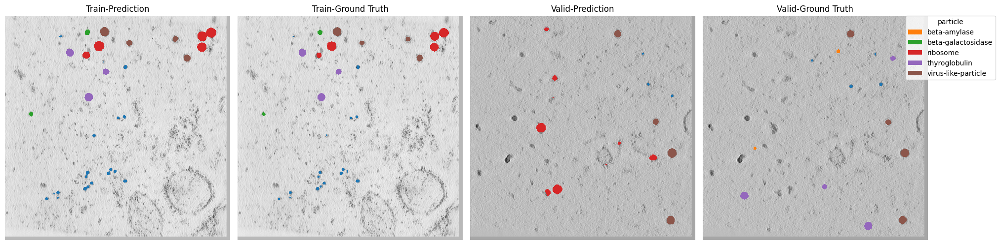

Train-Epoch: 12, Loss: 0.01169678393052891: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 12, Loss: 0.8825265069760407: 100%|██████████| 3680/3680 [02:37<00:00, 23.30it/s] 


EPOCH: 12, TRAIN_SCORE: 0.09284517973176207, TRAIN_SCORE_LIST: [0.08698889436630843, 0.10421309520631251, 0.09792042712449847, 0.10160005397365517, 0.07350342798803577]


Valid-Epoch: 12, Loss: 2.395644722186687: 100%|██████████| 368/368 [00:16<00:00, 22.10it/s]   


EPOCH: 12, VALID_SCORE: 0.09594748773179704, VALID_SCORE_LIST: [0.09602600669800986, 0.09586896876558423]


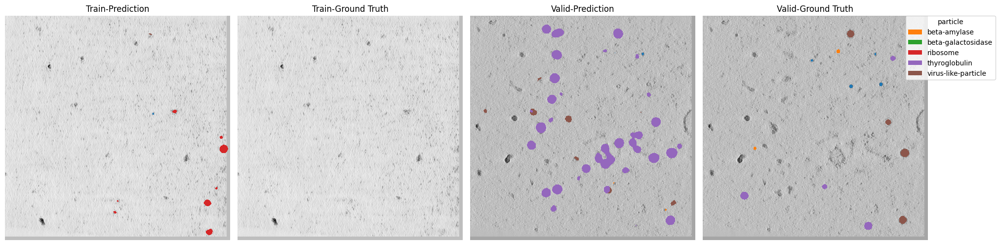

Train-Epoch: 13, Loss: 0.010206897484907962: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 13, Loss: 1.0082003428851634: 100%|██████████| 3680/3680 [02:37<00:00, 23.34it/s]  


EPOCH: 13, TRAIN_SCORE: 0.2296075158910996, TRAIN_SCORE_LIST: [0.20953414005454365, 0.20616317017989955, 0.26642142958114773, 0.23222317884466065, 0.23369566079524637]


Valid-Epoch: 13, Loss: 0.7760646529817301: 100%|██████████| 368/368 [00:16<00:00, 22.58it/s]  


EPOCH: 13, VALID_SCORE: 0.2619546375271306, VALID_SCORE_LIST: [0.30307481506325107, 0.22083445999101015]


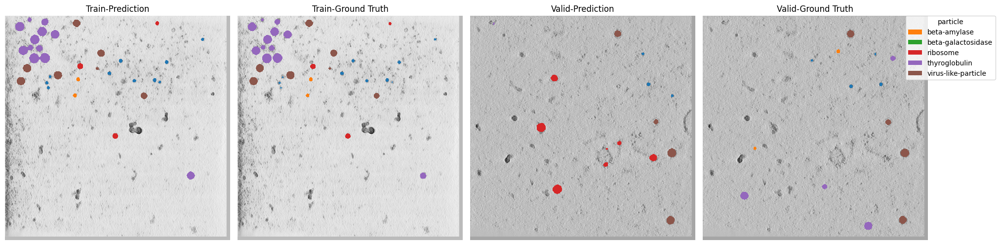

Train-Epoch: 14, Loss: 0.009950463051664764: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 14, Loss: 0.8868114200229483: 100%|██████████| 3680/3680 [02:38<00:00, 23.24it/s]  


EPOCH: 14, TRAIN_SCORE: 0.06280043975930324, TRAIN_SCORE_LIST: [0.05131269404386491, 0.07280572515755471, 0.08946711863668559, 0.05774071685859933, 0.042675944099811694]


Valid-Epoch: 14, Loss: 2.5554732592279774: 100%|██████████| 368/368 [00:16<00:00, 22.54it/s]  


EPOCH: 14, VALID_SCORE: 0.07825185258855177, VALID_SCORE_LIST: [0.07712991740379978, 0.07937378777330376]


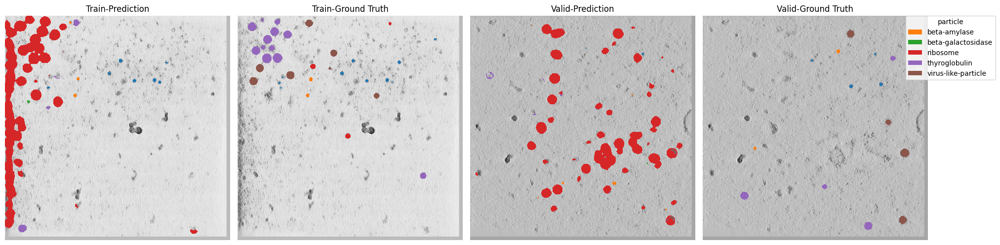

Train-Epoch: 15, Loss: 0.017422457194239224: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 15, Loss: 1.5624693132877907: 100%|██████████| 3680/3680 [02:37<00:00, 23.37it/s] 


EPOCH: 15, TRAIN_SCORE: 0.14630207983992363, TRAIN_SCORE_LIST: [0.12663922042372294, 0.11688129285895042, 0.158483569224502, 0.16421437522033244, 0.16529194147211032]


Valid-Epoch: 15, Loss: 0.6440309017265013: 100%|██████████| 368/368 [00:16<00:00, 22.26it/s]  


EPOCH: 15, VALID_SCORE: 0.23163006842278488, VALID_SCORE_LIST: [0.294057375236732, 0.16920276160883777]


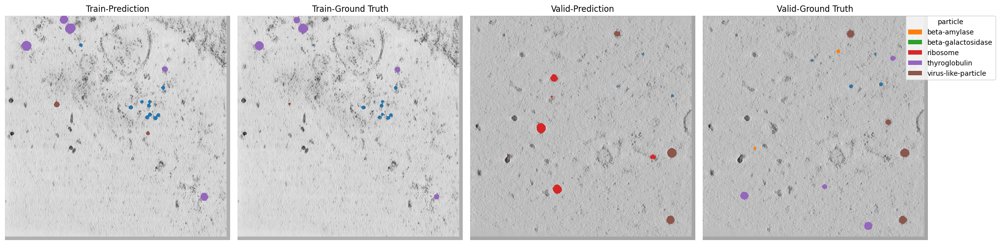

Train-Epoch: 16, Loss: 0.015415131975896657: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 16, Loss: 0.6152264736421241: 100%|██████████| 3680/3680 [02:38<00:00, 23.23it/s] 


EPOCH: 16, TRAIN_SCORE: 0.12551206876654394, TRAIN_SCORE_LIST: [0.12669418554565193, 0.12989281740609107, 0.14919946775891776, 0.11192678313584795, 0.10984708998621107]


Valid-Epoch: 16, Loss: 1.4430196623536977: 100%|██████████| 368/368 [00:16<00:00, 22.61it/s]  


EPOCH: 16, VALID_SCORE: 0.1480325655977101, VALID_SCORE_LIST: [0.15347991944385786, 0.14258521175156233]


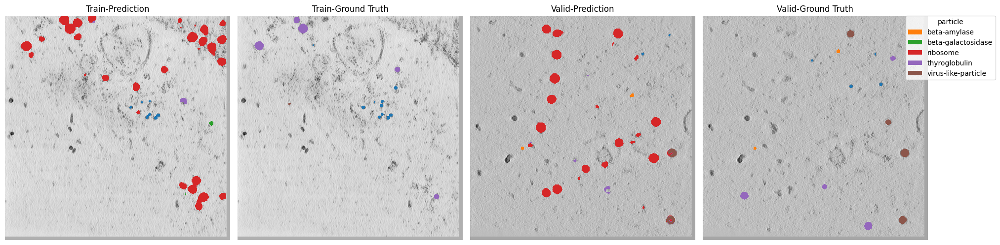

Train-Epoch: 17, Loss: 0.009079267429289125: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 17, Loss: 1.1381044363575281: 100%|██████████| 3680/3680 [02:37<00:00, 23.42it/s] 


EPOCH: 17, TRAIN_SCORE: 0.41984689798670705, TRAIN_SCORE_LIST: [0.42970556786651753, 0.41432271369963647, 0.4160842348156478, 0.41081045330067395, 0.4283115202510595]


Valid-Epoch: 17, Loss: 1.2862272404118398: 100%|██████████| 368/368 [00:16<00:00, 22.24it/s]  


EPOCH: 17, VALID_SCORE: 0.3916932670903339, VALID_SCORE_LIST: [0.47603182374914704, 0.30735471043152085]


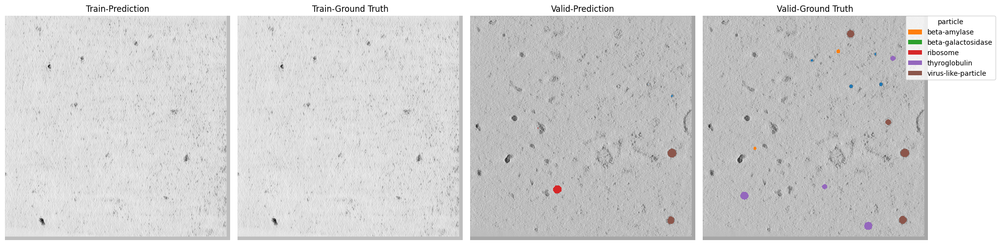

Train-Epoch: 18, Loss: 0.007700476070116881: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 18, Loss: 0.556190028146247: 100%|██████████| 3680/3680 [02:38<00:00, 23.24it/s]   


EPOCH: 18, TRAIN_SCORE: 0.06382223967196712, TRAIN_SCORE_LIST: [0.06058693668965243, 0.061575892885509374, 0.09286577718946942, 0.057390104838961224, 0.04669248675624319]


Valid-Epoch: 18, Loss: 1.0313751432149556: 100%|██████████| 368/368 [00:16<00:00, 22.68it/s] 


EPOCH: 18, VALID_SCORE: 0.14676453223555197, VALID_SCORE_LIST: [0.14687535969238205, 0.1466537047787219]


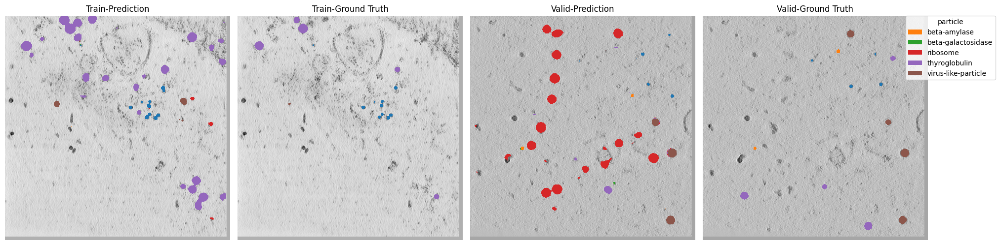

Train-Epoch: 19, Loss: 0.007852149457144348: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 19, Loss: 1.1766518453541375: 100%|██████████| 3680/3680 [02:37<00:00, 23.41it/s] 


EPOCH: 19, TRAIN_SCORE: 0.036940977590023134, TRAIN_SCORE_LIST: [0.04439129728415131, 0.028186407973008976, 0.04090685310624264, 0.03182102298861793, 0.0393993065980948]


Valid-Epoch: 19, Loss: 3.643589736973376: 100%|██████████| 368/368 [00:16<00:00, 22.25it/s]  


EPOCH: 19, VALID_SCORE: 0.05151633763798623, VALID_SCORE_LIST: [0.04689331619630456, 0.05613935907966789]


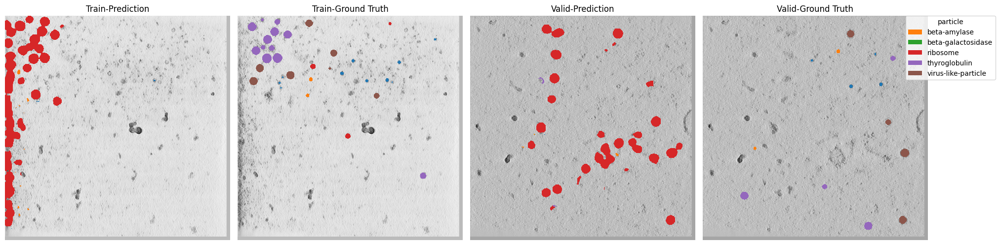

Train-Epoch: 20, Loss: 0.007968428852441518: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 20, Loss: 1.0122722447591903: 100%|██████████| 3680/3680 [02:38<00:00, 23.21it/s]  


EPOCH: 20, TRAIN_SCORE: 0.16858136204712984, TRAIN_SCORE_LIST: [0.16849657505133628, 0.14980570378756483, 0.2060231350355261, 0.1650070400690406, 0.15357435629218147]


Valid-Epoch: 20, Loss: 0.783595279873492: 100%|██████████| 368/368 [00:16<00:00, 22.61it/s]   


EPOCH: 20, VALID_SCORE: 0.2231087146340519, VALID_SCORE_LIST: [0.2520983308780003, 0.19411909839010347]


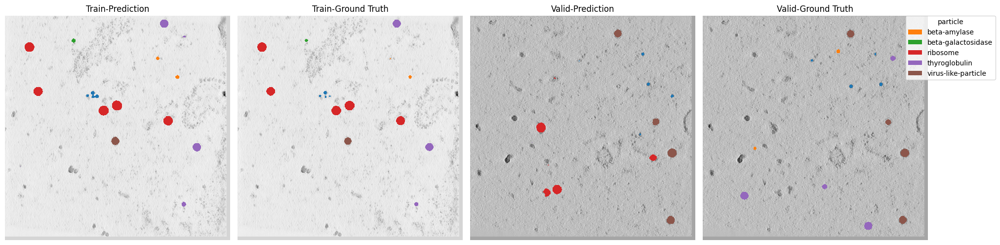

Train-Epoch: 21, Loss: 0.0072688828852614795: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 21, Loss: 1.193753704918628: 100%|██████████| 3680/3680 [02:37<00:00, 23.42it/s]   


EPOCH: 21, TRAIN_SCORE: 0.3081908986571956, TRAIN_SCORE_LIST: [0.3004760894772862, 0.30197826842853637, 0.35252861782923045, 0.2934115027646413, 0.2925600147862836]


Valid-Epoch: 21, Loss: 1.0711746839426513: 100%|██████████| 368/368 [00:16<00:00, 22.20it/s]  


EPOCH: 21, VALID_SCORE: 0.2734620007241418, VALID_SCORE_LIST: [0.33465056653043196, 0.2122734349178516]


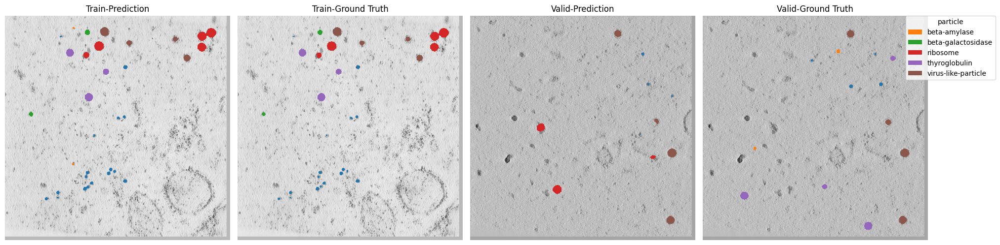

Train-Epoch: 22, Loss: 0.006846880686783192: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 22, Loss: 0.9907406178507835: 100%|██████████| 3680/3680 [02:38<00:00, 23.21it/s] 


EPOCH: 22, TRAIN_SCORE: 0.11659596180509402, TRAIN_SCORE_LIST: [0.12253645113935127, 0.11494152294204532, 0.11664315263664235, 0.13269045054458087, 0.09616823176285032]


Valid-Epoch: 22, Loss: 3.096090082075563: 100%|██████████| 368/368 [00:16<00:00, 22.29it/s]   


EPOCH: 22, VALID_SCORE: 0.09879104751436665, VALID_SCORE_LIST: [0.09435807425519138, 0.10322402077354194]


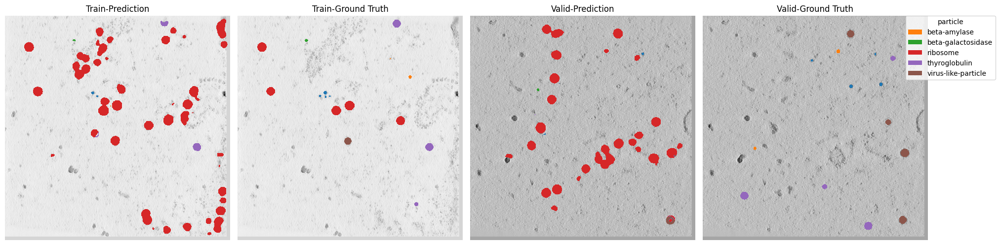

Train-Epoch: 23, Loss: 0.007034822106209543: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 23, Loss: 0.7756730966855879: 100%|██████████| 3680/3680 [02:36<00:00, 23.45it/s] 


EPOCH: 23, TRAIN_SCORE: 0.13778465224415085, TRAIN_SCORE_LIST: [0.1491340729545533, 0.15528026056694752, 0.1345773857965416, 0.1541236709826774, 0.09580787092003439]


Valid-Epoch: 23, Loss: 1.6019594940399364: 100%|██████████| 368/368 [00:16<00:00, 22.71it/s]  


EPOCH: 23, VALID_SCORE: 0.1542679940804531, VALID_SCORE_LIST: [0.1538186319205362, 0.15471735624037]


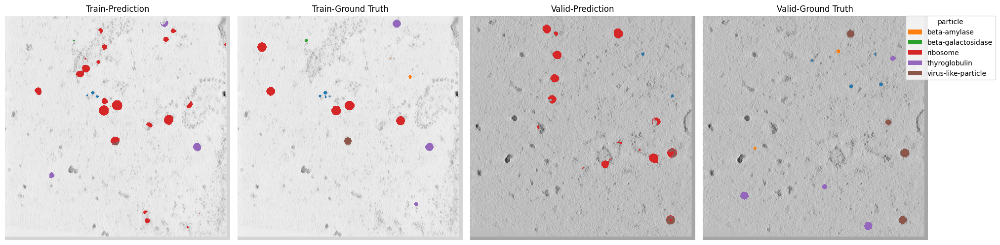

Train-Epoch: 24, Loss: 0.006791090035719959: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 24, Loss: 1.1541361874575051: 100%|██████████| 3680/3680 [02:38<00:00, 23.22it/s]  


EPOCH: 24, TRAIN_SCORE: 0.18979756288342742, TRAIN_SCORE_LIST: [0.17588041330181753, 0.18600678532845658, 0.2131926347660393, 0.18767450298275792, 0.18623347803806573]


Valid-Epoch: 24, Loss: 0.9179396494815343: 100%|██████████| 368/368 [00:16<00:00, 22.01it/s]  


EPOCH: 24, VALID_SCORE: 0.2965778930462358, VALID_SCORE_LIST: [0.32211822850637944, 0.2710375575860921]


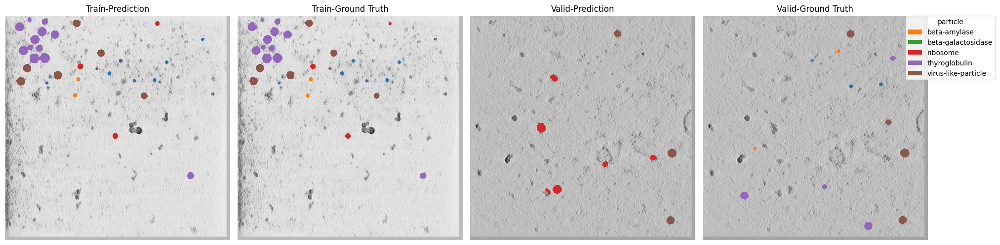

Train-Epoch: 25, Loss: 0.007052849979347388: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 25, Loss: 0.7527742726659633: 100%|██████████| 3680/3680 [02:36<00:00, 23.46it/s]  


EPOCH: 25, TRAIN_SCORE: 0.15930443363399202, TRAIN_SCORE_LIST: [0.14239150824200705, 0.16305883834869064, 0.18125827232098715, 0.17998289602176687, 0.12983065323650841]


Valid-Epoch: 25, Loss: 1.5428541732091603: 100%|██████████| 368/368 [00:16<00:00, 22.40it/s]  


EPOCH: 25, VALID_SCORE: 0.19380514092638088, VALID_SCORE_LIST: [0.20162650043772531, 0.18598378141503644]


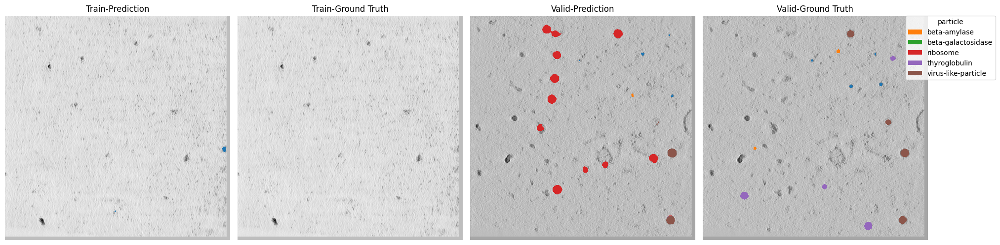

Train-Epoch: 26, Loss: 0.0071122056880520415: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 26, Loss: 0.7580390001116727: 100%|██████████| 3680/3680 [02:38<00:00, 23.25it/s] 


EPOCH: 26, TRAIN_SCORE: 0.10914745326071391, TRAIN_SCORE_LIST: [0.11221925853988128, 0.12089472235422181, 0.09547090006362548, 0.11080405054806715, 0.10634833479777382]


Valid-Epoch: 26, Loss: 2.1269851124219237: 100%|██████████| 368/368 [00:17<00:00, 21.62it/s]  


EPOCH: 26, VALID_SCORE: 0.11173368392232076, VALID_SCORE_LIST: [0.1266719065375546, 0.09679546130708691]


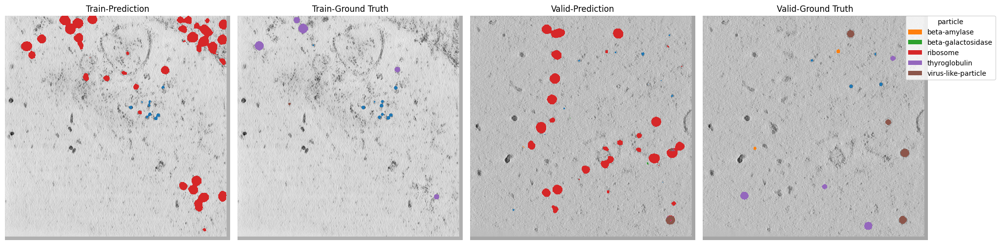

Train-Epoch: 27, Loss: 0.01271187197872559: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 27, Loss: 0.9272762570832146: 100%|██████████| 3680/3680 [02:37<00:00, 23.33it/s]


EPOCH: 27, TRAIN_SCORE: 0.15381454621981272, TRAIN_SCORE_LIST: [0.13100359184361196, 0.18065934152972915, 0.17594973292638597, 0.15804911709287417, 0.1234109477064623]


Valid-Epoch: 27, Loss: 1.8203459944371232: 100%|██████████| 368/368 [00:16<00:00, 22.82it/s] 


EPOCH: 27, VALID_SCORE: 0.1637430530371739, VALID_SCORE_LIST: [0.134102568940702, 0.1933835371336458]


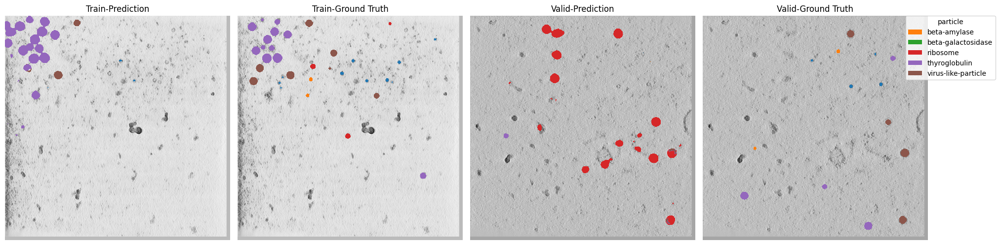

Train-Epoch: 28, Loss: 0.008322322221331136: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 28, Loss: 1.3200449782336587: 100%|██████████| 3680/3680 [02:38<00:00, 23.23it/s]  


EPOCH: 28, TRAIN_SCORE: 0.2939150027102076, TRAIN_SCORE_LIST: [0.277428185797076, 0.2646926933962532, 0.3291486853908236, 0.3177022060488189, 0.28060324291806615]


Valid-Epoch: 28, Loss: 0.9311741494910888: 100%|██████████| 368/368 [00:16<00:00, 22.42it/s]  


EPOCH: 28, VALID_SCORE: 0.34003105048524707, VALID_SCORE_LIST: [0.3983018758122511, 0.281760225158243]


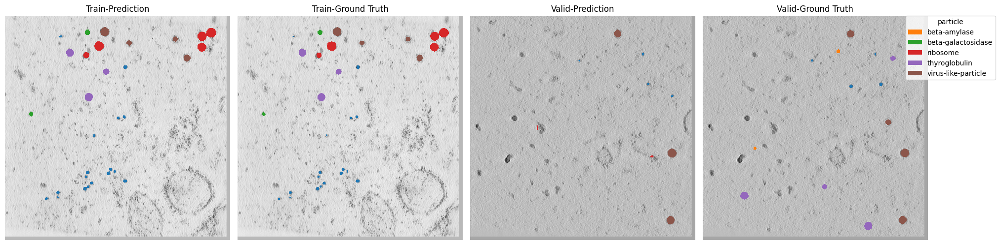

Train-Epoch: 29, Loss: 0.007077873548437113: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s] 
Train-nshuffle-Epoch: 29, Loss: 0.7296274436124369: 100%|██████████| 3680/3680 [02:37<00:00, 23.34it/s] 


EPOCH: 29, TRAIN_SCORE: 0.15019975342307576, TRAIN_SCORE_LIST: [0.13382016086989082, 0.15354321700990908, 0.15875375112702814, 0.16089420824963532, 0.14398742985891547]


Valid-Epoch: 29, Loss: 2.252620114370379: 100%|██████████| 368/368 [00:16<00:00, 22.29it/s]   


EPOCH: 29, VALID_SCORE: 0.08877558816865899, VALID_SCORE_LIST: [0.06899520724782124, 0.10855596908949673]


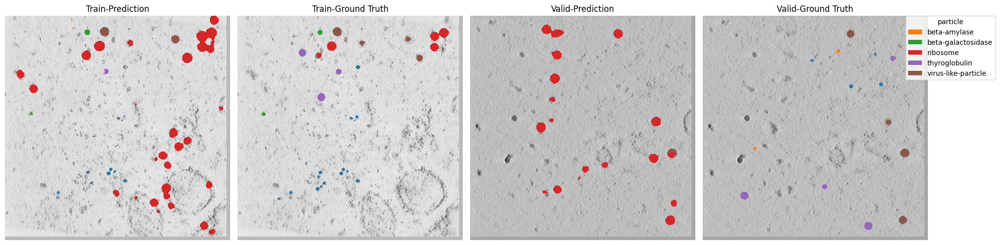

Train-Epoch: 30, Loss: 0.005992209390103159: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 30, Loss: 0.49047341434606423: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s] 


EPOCH: 30, TRAIN_SCORE: 0.07873083284082422, TRAIN_SCORE_LIST: [0.0798253352961031, 0.07795581213801418, 0.09540443247106198, 0.07899585961860396, 0.06147272468033787]


Valid-Epoch: 30, Loss: 1.3370441951656398: 100%|██████████| 368/368 [00:16<00:00, 22.72it/s]  


EPOCH: 30, VALID_SCORE: 0.07680909654847454, VALID_SCORE_LIST: [0.08386838884644875, 0.06974980425050033]


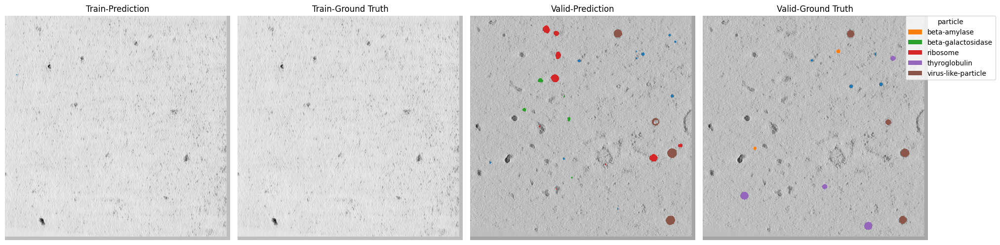

Train-Epoch: 31, Loss: 0.0057565601567899725: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s]
Train-nshuffle-Epoch: 31, Loss: 0.8043807819691652: 100%|██████████| 3680/3680 [02:37<00:00, 23.33it/s]  


EPOCH: 31, TRAIN_SCORE: 0.17510210256040248, TRAIN_SCORE_LIST: [0.1721912147220228, 0.17931154877971903, 0.14374300787318384, 0.18925439020728776, 0.1910103512197991]


Valid-Epoch: 31, Loss: 2.2211330573164676: 100%|██████████| 368/368 [00:16<00:00, 22.05it/s]  


EPOCH: 31, VALID_SCORE: 0.17997584450968396, VALID_SCORE_LIST: [0.17698477349028105, 0.1829669155290869]


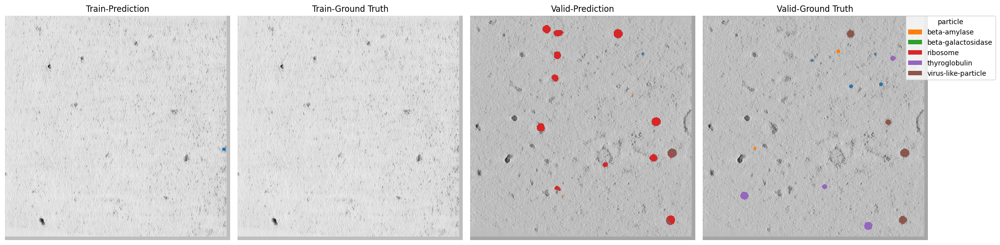

Train-Epoch: 32, Loss: 0.004930360543253103: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 32, Loss: 1.238437655159343: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s]   


EPOCH: 32, TRAIN_SCORE: 0.2483979467178609, TRAIN_SCORE_LIST: [0.2737773713019885, 0.24360312265520065, 0.2464095351806452, 0.2526929422119832, 0.22550676223948687]


Valid-Epoch: 32, Loss: 1.0988357935920163: 100%|██████████| 368/368 [00:16<00:00, 22.57it/s] 


EPOCH: 32, VALID_SCORE: 0.4071639708694716, VALID_SCORE_LIST: [0.48465950534037444, 0.32966843639856874]


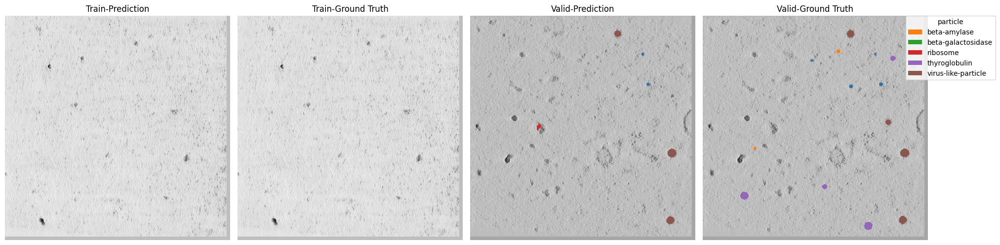

Train-Epoch: 33, Loss: 0.006601136541449586: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 33, Loss: 0.8485825180582827: 100%|██████████| 3680/3680 [02:37<00:00, 23.32it/s]  


EPOCH: 33, TRAIN_SCORE: 0.10525068014659796, TRAIN_SCORE_LIST: [0.10404721685672129, 0.11299648395354253, 0.12276005229732119, 0.10502367195152622, 0.08142597567387859]


Valid-Epoch: 33, Loss: 2.628904324633016: 100%|██████████| 368/368 [00:17<00:00, 21.60it/s]   


EPOCH: 33, VALID_SCORE: 0.09865462597016603, VALID_SCORE_LIST: [0.09779753682322553, 0.0995117151171065]


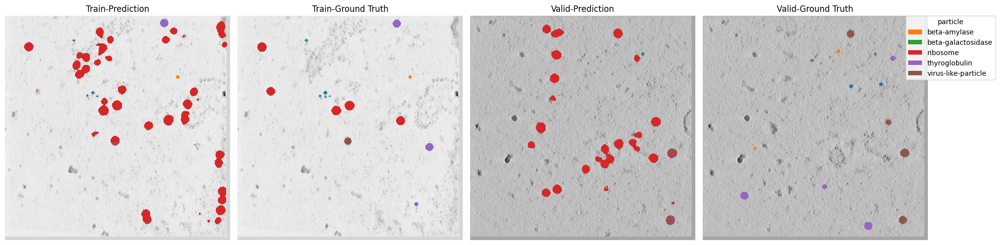

Train-Epoch: 34, Loss: 0.005037295028223129: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 34, Loss: 1.0582482387377266: 100%|██████████| 3680/3680 [02:37<00:00, 23.31it/s]  


EPOCH: 34, TRAIN_SCORE: 0.10862609944325316, TRAIN_SCORE_LIST: [0.10789266428846608, 0.11211221993553702, 0.08926009930079397, 0.08732750896549045, 0.14653800472597828]


Valid-Epoch: 34, Loss: 2.2111062032493543: 100%|██████████| 368/368 [00:16<00:00, 22.50it/s] 


EPOCH: 34, VALID_SCORE: 0.11245097617688127, VALID_SCORE_LIST: [0.1343999283600686, 0.09050202399369393]


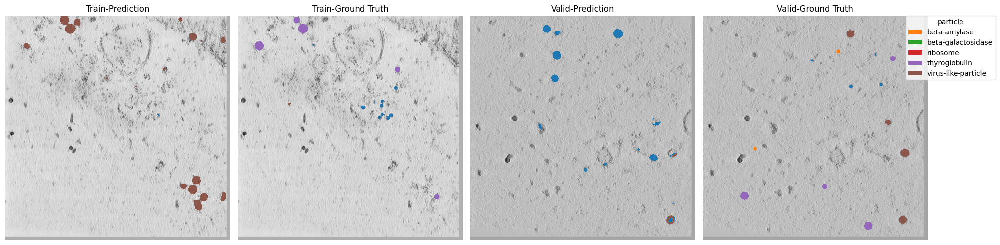

Train-Epoch: 35, Loss: 0.00478915772666527: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s]  
Train-nshuffle-Epoch: 35, Loss: 0.7566788780680515: 100%|██████████| 3680/3680 [02:38<00:00, 23.26it/s] 


EPOCH: 35, TRAIN_SCORE: 0.07127883770007933, TRAIN_SCORE_LIST: [0.06383035701795, 0.06980349921527573, 0.10519632055918884, 0.06857389267045713, 0.048990119037524926]


Valid-Epoch: 35, Loss: 2.492548344777835: 100%|██████████| 368/368 [00:16<00:00, 22.65it/s]  


EPOCH: 35, VALID_SCORE: 0.07170172551290085, VALID_SCORE_LIST: [0.06900527896648755, 0.07439817205931416]


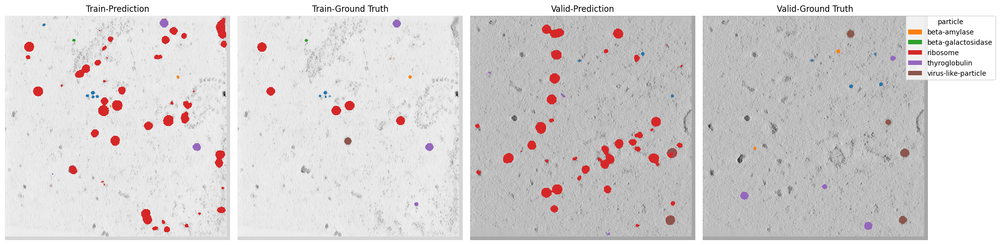

Train-Epoch: 36, Loss: 0.004757586317314037: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 36, Loss: 1.1042704426132637: 100%|██████████| 3680/3680 [02:37<00:00, 23.41it/s]  


EPOCH: 36, TRAIN_SCORE: 0.09280279532512134, TRAIN_SCORE_LIST: [0.10587144688879746, 0.11258293671967425, 0.07253413708547243, 0.08872528829509828, 0.08430016763656431]


Valid-Epoch: 36, Loss: 3.3062513987256996: 100%|██████████| 368/368 [00:16<00:00, 22.08it/s]  


EPOCH: 36, VALID_SCORE: 0.07481041949449466, VALID_SCORE_LIST: [0.08344984649418244, 0.06617099249480687]


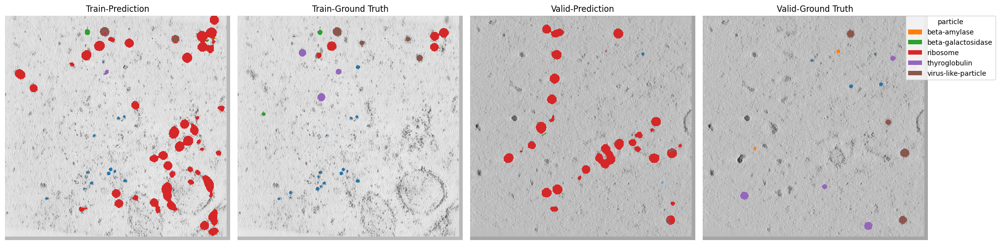

Train-Epoch: 37, Loss: 0.004522350574489278: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s] 
Train-nshuffle-Epoch: 37, Loss: 1.2143652717969622: 100%|██████████| 3680/3680 [02:37<00:00, 23.29it/s]  


EPOCH: 37, TRAIN_SCORE: 0.21378530968746895, TRAIN_SCORE_LIST: [0.19935761262991963, 0.2058401302522397, 0.23104420365484774, 0.22393595900982036, 0.20874864289051723]


Valid-Epoch: 37, Loss: 1.0653818086719375: 100%|██████████| 368/368 [00:16<00:00, 22.37it/s]  


EPOCH: 37, VALID_SCORE: 0.2942589060334253, VALID_SCORE_LIST: [0.3491844051065832, 0.23933340696026745]


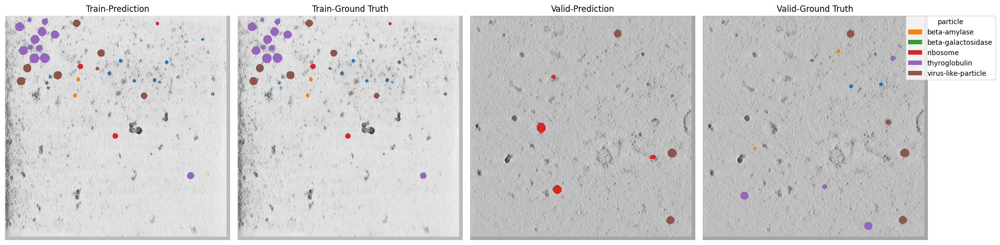

Train-Epoch: 38, Loss: 0.004332036232960451: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 38, Loss: 0.6798365539827769: 100%|██████████| 3680/3680 [02:37<00:00, 23.33it/s]  


EPOCH: 38, TRAIN_SCORE: 0.07485143678797263, TRAIN_SCORE_LIST: [0.06677718598356276, 0.07671767884875538, 0.09894979620271696, 0.07511209539260169, 0.05670042751222631]


Valid-Epoch: 38, Loss: 1.6615149295420186: 100%|██████████| 368/368 [00:16<00:00, 21.99it/s] 


EPOCH: 38, VALID_SCORE: 0.14616404291517943, VALID_SCORE_LIST: [0.14582163450948724, 0.14650645132087164]


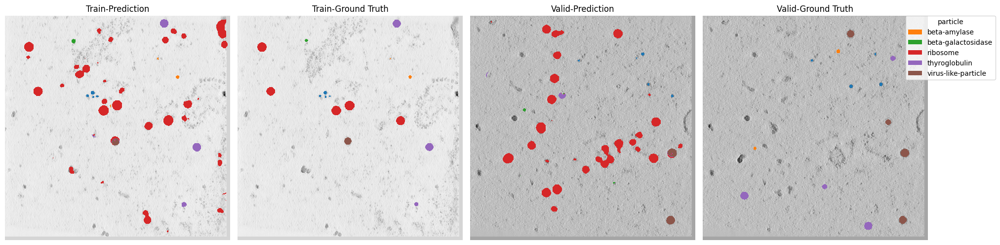

Train-Epoch: 39, Loss: 0.004278144465238058: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 39, Loss: 1.623988973063856: 100%|██████████| 3680/3680 [02:38<00:00, 23.21it/s]  


EPOCH: 39, TRAIN_SCORE: 0.43661638200245456, TRAIN_SCORE_LIST: [0.43391048498372875, 0.45724716671712035, 0.44713930615454106, 0.4234223677203683, 0.4213625844365145]


Valid-Epoch: 39, Loss: 1.9212580340281222: 100%|██████████| 368/368 [00:16<00:00, 22.38it/s]  


EPOCH: 39, VALID_SCORE: 0.2669185240293343, VALID_SCORE_LIST: [0.3036416642516365, 0.23019538380703208]


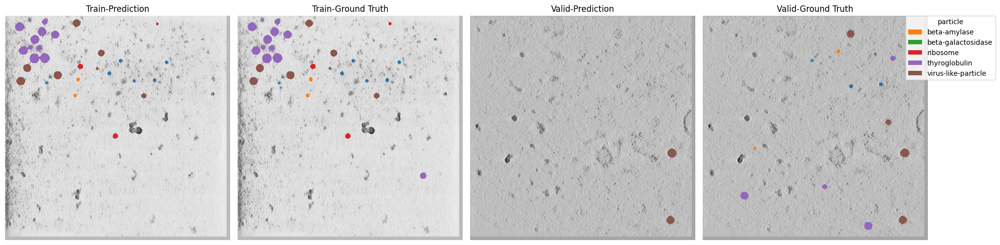

Train-Epoch: 40, Loss: 0.004522112147685181: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 40, Loss: 1.8403767100804158: 100%|██████████| 3680/3680 [02:37<00:00, 23.35it/s]  


EPOCH: 40, TRAIN_SCORE: 0.03539222674629747, TRAIN_SCORE_LIST: [0.03943795383245209, 0.03085417645464806, 0.028547608261998408, 0.030977399191625943, 0.047143995990762834]


Valid-Epoch: 40, Loss: 5.724841236096302: 100%|██████████| 368/368 [00:16<00:00, 22.34it/s]  


EPOCH: 40, VALID_SCORE: 0.04758388984709756, VALID_SCORE_LIST: [0.03969723614642245, 0.05547054354777268]


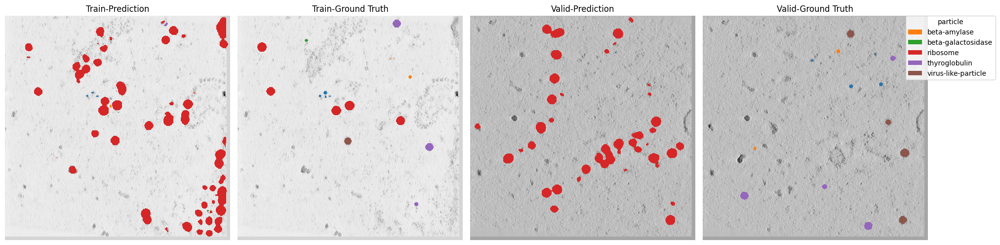

Train-Epoch: 41, Loss: 0.004412430262005807: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 41, Loss: 0.6910020931949031: 100%|██████████| 3680/3680 [02:38<00:00, 23.22it/s]  


EPOCH: 41, TRAIN_SCORE: 0.127170997447867, TRAIN_SCORE_LIST: [0.11835839491665504, 0.14755776929492304, 0.10860997901137234, 0.15910225794362634, 0.10222658607275827]


Valid-Epoch: 41, Loss: 1.902046751795399: 100%|██████████| 368/368 [00:16<00:00, 21.91it/s]   


EPOCH: 41, VALID_SCORE: 0.1151560971650922, VALID_SCORE_LIST: [0.11999649658703516, 0.11031569774314923]


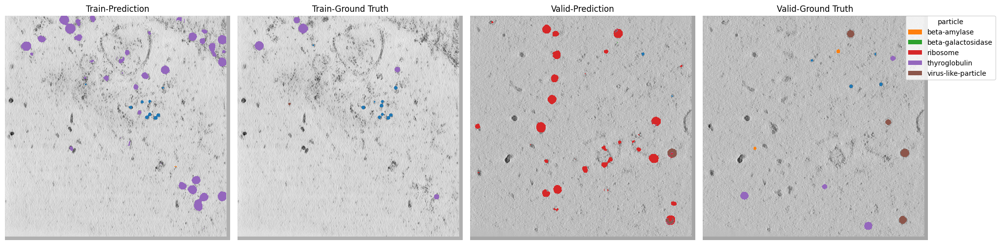

Train-Epoch: 42, Loss: 0.009105465492820772: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 42, Loss: 1.2465780839091727: 100%|██████████| 3680/3680 [02:37<00:00, 23.31it/s]


EPOCH: 42, TRAIN_SCORE: 0.18756435667453183, TRAIN_SCORE_LIST: [0.2074660660263277, 0.20200960394366407, 0.19621008568437942, 0.18499400853078177, 0.14714201918750633]


Valid-Epoch: 42, Loss: 1.4042252449180523: 100%|██████████| 368/368 [00:16<00:00, 22.45it/s]


EPOCH: 42, VALID_SCORE: 0.1768134459893845, VALID_SCORE_LIST: [0.1952358873927562, 0.1583910045860128]


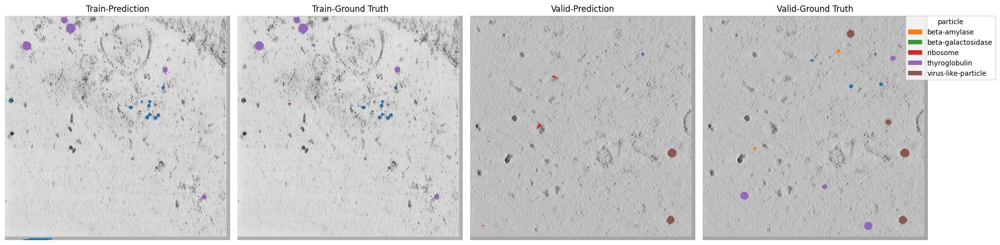

Train-Epoch: 43, Loss: 0.005432026144673886: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s] 
Train-nshuffle-Epoch: 43, Loss: 1.4260359204353903: 100%|██████████| 3680/3680 [02:39<00:00, 23.11it/s]  


EPOCH: 43, TRAIN_SCORE: 0.1569908209931375, TRAIN_SCORE_LIST: [0.14409248242410122, 0.16835609903089035, 0.1833000400493407, 0.14581473621095872, 0.1433907472503965]


Valid-Epoch: 43, Loss: 1.1271637098013678: 100%|██████████| 368/368 [00:16<00:00, 21.69it/s] 


EPOCH: 43, VALID_SCORE: 0.31015116002342014, VALID_SCORE_LIST: [0.35285744984396467, 0.26744487020287566]


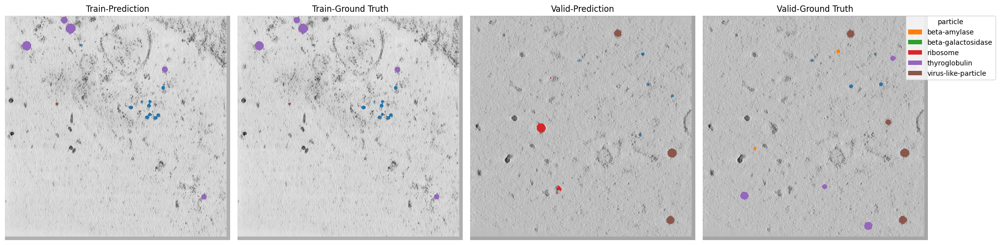

Train-Epoch: 44, Loss: 0.004012880136218408: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 44, Loss: 0.3672384266481314: 100%|██████████| 3680/3680 [02:37<00:00, 23.34it/s]  


EPOCH: 44, TRAIN_SCORE: 0.06725123482904596, TRAIN_SCORE_LIST: [0.059509725415675764, 0.08025618221462336, 0.08940587979219317, 0.05863457728550202, 0.04844980943723555]


Valid-Epoch: 44, Loss: 1.4960832759805014: 100%|██████████| 368/368 [00:16<00:00, 22.66it/s]  


EPOCH: 44, VALID_SCORE: 0.1124518969219141, VALID_SCORE_LIST: [0.11121605728474944, 0.11368773655907875]


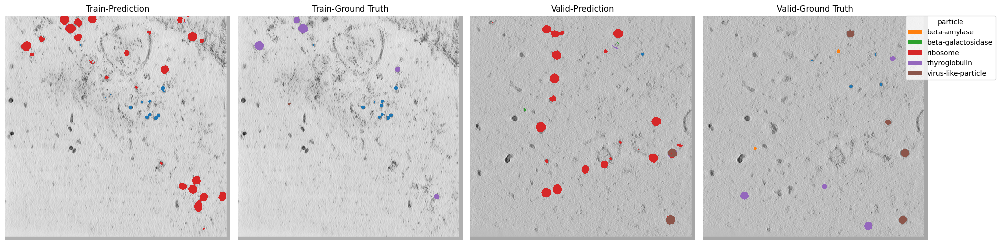

Train-Epoch: 45, Loss: 0.0037461304261460497: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 45, Loss: 1.4593186856565392: 100%|██████████| 3680/3680 [02:38<00:00, 23.22it/s]  


EPOCH: 45, TRAIN_SCORE: 0.13575869416194972, TRAIN_SCORE_LIST: [0.1330059316282631, 0.1412891122746374, 0.13615935271525456, 0.14684219338705318, 0.12149688080454038]


Valid-Epoch: 45, Loss: 1.2011470846998658: 100%|██████████| 368/368 [00:16<00:00, 21.90it/s]  


EPOCH: 45, VALID_SCORE: 0.33553880332007846, VALID_SCORE_LIST: [0.3854757816660697, 0.28560182497408715]


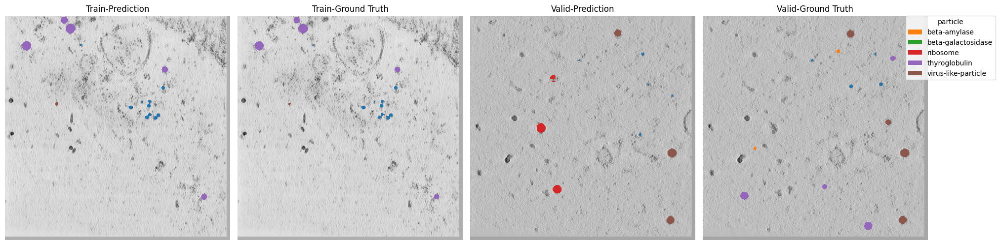

Train-Epoch: 46, Loss: 0.0035438592373595937: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 46, Loss: 1.4702605678198333: 100%|██████████| 3680/3680 [02:37<00:00, 23.34it/s]  


EPOCH: 46, TRAIN_SCORE: 0.1488088150723147, TRAIN_SCORE_LIST: [0.13142027223804417, 0.14983149957212602, 0.18100652822578397, 0.14740439513085785, 0.1343813801947614]


Valid-Epoch: 46, Loss: 1.05864457020272: 100%|██████████| 368/368 [00:16<00:00, 22.33it/s]    


EPOCH: 46, VALID_SCORE: 0.20877624264533098, VALID_SCORE_LIST: [0.23750133175002341, 0.18005115354063855]


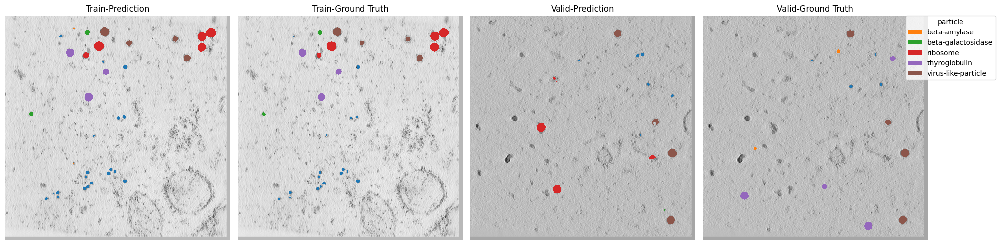

Train-Epoch: 47, Loss: 0.008302839529072946: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 47, Loss: 0.6308754084956523: 100%|██████████| 3680/3680 [02:38<00:00, 23.27it/s] 


EPOCH: 47, TRAIN_SCORE: 0.12506870495428005, TRAIN_SCORE_LIST: [0.10836659183639388, 0.12725764583693558, 0.1590758807998974, 0.12356427129870573, 0.10707913499946768]


Valid-Epoch: 47, Loss: 1.602267137869265: 100%|██████████| 368/368 [00:16<00:00, 22.47it/s]   


EPOCH: 47, VALID_SCORE: 0.17717684192818284, VALID_SCORE_LIST: [0.1904193713563001, 0.1639343125000656]


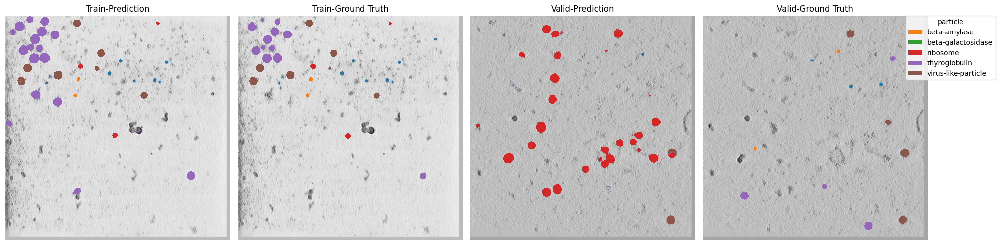

Train-Epoch: 48, Loss: 0.004400434526716075: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 48, Loss: 1.3880183178128322: 100%|██████████| 3680/3680 [02:37<00:00, 23.37it/s]  


EPOCH: 48, TRAIN_SCORE: 0.32775584539292374, TRAIN_SCORE_LIST: [0.3279257874226386, 0.3340796704865663, 0.3519180651922197, 0.30031924719695346, 0.32453645666624054]


Valid-Epoch: 48, Loss: 1.0812212082286805: 100%|██████████| 368/368 [00:16<00:00, 22.27it/s] 


EPOCH: 48, VALID_SCORE: 0.35161979389487485, VALID_SCORE_LIST: [0.43453717440518563, 0.268702413384564]


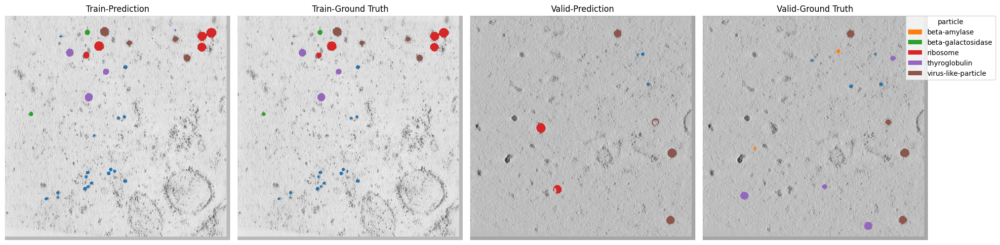

Train-Epoch: 49, Loss: 0.0035925960889511294: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 49, Loss: 2.270259813566507: 100%|██████████| 3680/3680 [02:38<00:00, 23.19it/s]  


EPOCH: 49, TRAIN_SCORE: 0.432058345673869, TRAIN_SCORE_LIST: [0.4438831282779743, 0.4286495095596852, 0.4302937241110515, 0.4275786960241487, 0.42988667039648565]


Valid-Epoch: 49, Loss: 1.7851872811696234: 100%|██████████| 368/368 [00:16<00:00, 21.86it/s]  


EPOCH: 49, VALID_SCORE: 0.3612871684756803, VALID_SCORE_LIST: [0.4088214859424341, 0.3137528510089266]


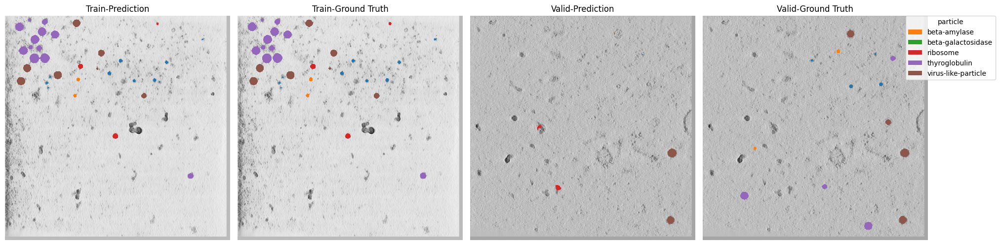

Train-Epoch: 50, Loss: 0.003436635799817336: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 50, Loss: 0.7728463183768725: 100%|██████████| 3680/3680 [02:38<00:00, 23.25it/s]  


EPOCH: 50, TRAIN_SCORE: 0.0949539288132655, TRAIN_SCORE_LIST: [0.09034273918809484, 0.11868782062591278, 0.09784278814474512, 0.08946323422938797, 0.07843306187818674]


Valid-Epoch: 50, Loss: 2.679370422680004: 100%|██████████| 368/368 [00:16<00:00, 22.52it/s]  


EPOCH: 50, VALID_SCORE: 0.09591818588069273, VALID_SCORE_LIST: [0.1064049070886974, 0.08543146467268804]


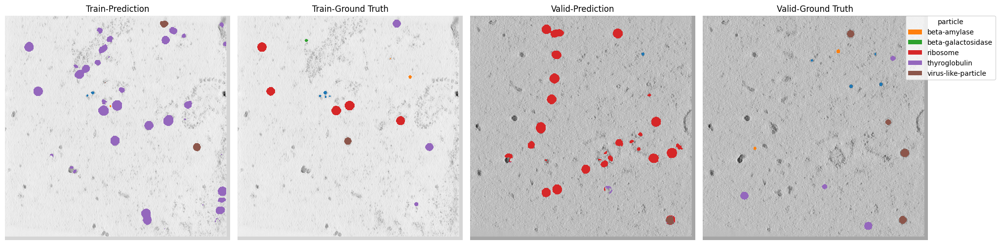

Train-Epoch: 51, Loss: 0.0031496383253555825: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 51, Loss: 1.9149177564047515: 100%|██████████| 3680/3680 [02:39<00:00, 23.14it/s]  


EPOCH: 51, TRAIN_SCORE: 0.36736369984459205, TRAIN_SCORE_LIST: [0.373214645345593, 0.3808955102532624, 0.3668367066813779, 0.37131962982633143, 0.3445520071163953]


Valid-Epoch: 51, Loss: 1.491166770170533: 100%|██████████| 368/368 [00:16<00:00, 21.97it/s]   


EPOCH: 51, VALID_SCORE: 0.34317967423720863, VALID_SCORE_LIST: [0.40154028077433096, 0.28481906770008625]


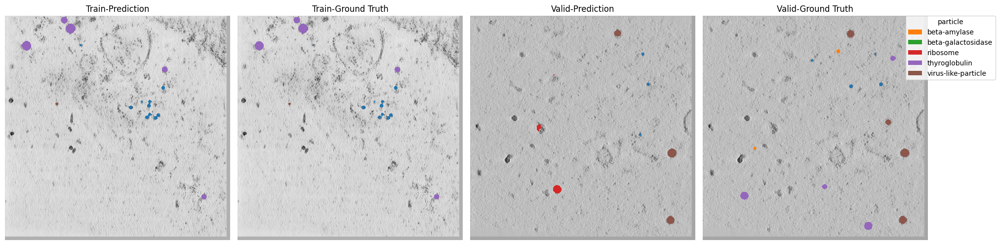

Train-Epoch: 52, Loss: 0.0033027050086631158: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 52, Loss: 0.5782125697761928: 100%|██████████| 3680/3680 [02:37<00:00, 23.37it/s] 


EPOCH: 52, TRAIN_SCORE: 0.08709566306452377, TRAIN_SCORE_LIST: [0.07994216501155327, 0.09046107793344527, 0.11270592663604372, 0.08348843647620353, 0.06888070926537306]


Valid-Epoch: 52, Loss: 1.4822321731954946: 100%|██████████| 368/368 [00:16<00:00, 22.68it/s]  


EPOCH: 52, VALID_SCORE: 0.19009252510972297, VALID_SCORE_LIST: [0.20500664942268582, 0.17517840079676011]


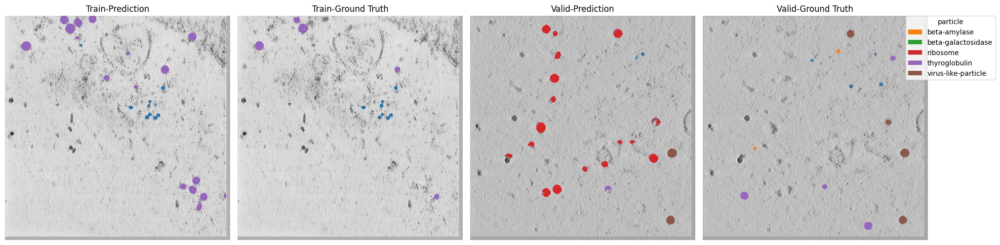

Train-Epoch: 53, Loss: 0.00306018221245208: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]  
Train-nshuffle-Epoch: 53, Loss: 0.5756895544245481: 100%|██████████| 3680/3680 [02:38<00:00, 23.15it/s]  


EPOCH: 53, TRAIN_SCORE: 0.07731707403332762, TRAIN_SCORE_LIST: [0.06401265937954793, 0.0779729650348165, 0.1080588817676962, 0.07645879221750333, 0.06008207176707409]


Valid-Epoch: 53, Loss: 1.5157412179784404: 100%|██████████| 368/368 [00:16<00:00, 22.15it/s]  


EPOCH: 53, VALID_SCORE: 0.15547350771805019, VALID_SCORE_LIST: [0.16342955205596396, 0.1475174633801364]


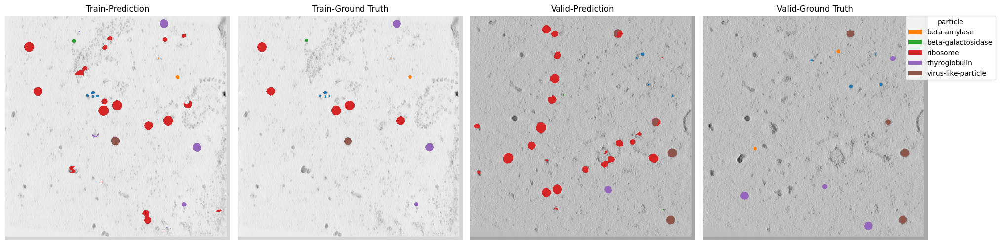

Train-Epoch: 54, Loss: 0.0030757851392516624: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 54, Loss: 2.592564436762038: 100%|██████████| 3680/3680 [02:37<00:00, 23.37it/s]  


EPOCH: 54, TRAIN_SCORE: 0.4305924655326683, TRAIN_SCORE_LIST: [0.44279952820798, 0.43407130483528, 0.4202103601481171, 0.44103412599208863, 0.41484700847987555]


Valid-Epoch: 54, Loss: 2.062653184890334: 100%|██████████| 368/368 [00:16<00:00, 21.97it/s]   


EPOCH: 54, VALID_SCORE: 0.34332663198434676, VALID_SCORE_LIST: [0.40558908980391134, 0.2810641741647822]


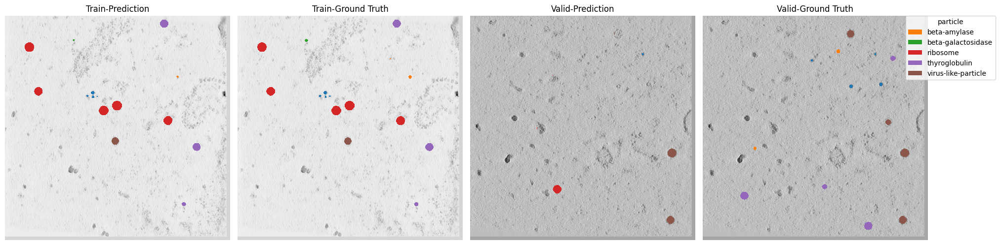

Train-Epoch: 55, Loss: 0.003273648007661509: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 55, Loss: 0.907110999095886: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s]  


EPOCH: 55, TRAIN_SCORE: 0.06230997356992428, TRAIN_SCORE_LIST: [0.054214301225267436, 0.0599018422873859, 0.08761650237718185, 0.05535694129919555, 0.05446028066059065]


Valid-Epoch: 55, Loss: 3.242088679252512: 100%|██████████| 368/368 [00:16<00:00, 22.76it/s]  


EPOCH: 55, VALID_SCORE: 0.08075729241815023, VALID_SCORE_LIST: [0.07150734168003177, 0.0900072431562687]


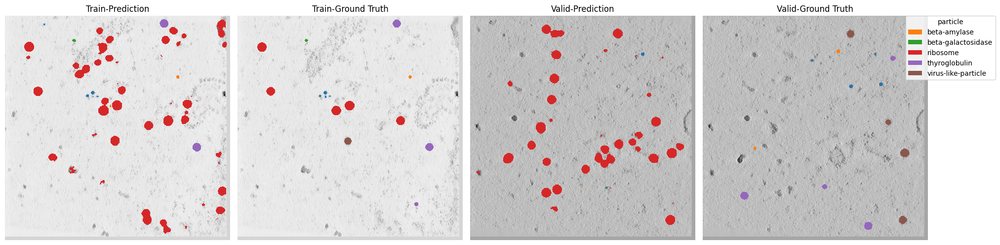

Train-Epoch: 56, Loss: 0.003132369784187809: 100%|██████████| 460/460 [04:09<00:00,  1.85it/s] 
Train-nshuffle-Epoch: 56, Loss: 0.644404286891186: 100%|██████████| 3680/3680 [02:37<00:00, 23.38it/s]   


EPOCH: 56, TRAIN_SCORE: 0.1401415208665549, TRAIN_SCORE_LIST: [0.13812347893782065, 0.15239208757910935, 0.16090571673050505, 0.14719406015360662, 0.10209226093173297]


Valid-Epoch: 56, Loss: 1.8844477245445455: 100%|██████████| 368/368 [00:16<00:00, 22.39it/s]  


EPOCH: 56, VALID_SCORE: 0.18409947806720914, VALID_SCORE_LIST: [0.20916107681239257, 0.1590378793220257]


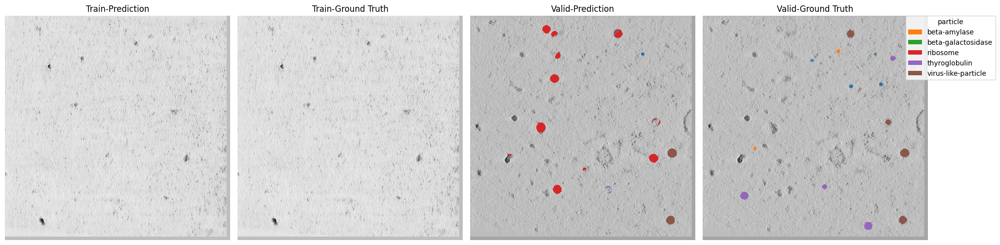

Train-Epoch: 57, Loss: 0.003176463563020503: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 57, Loss: 0.664359280545856: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s]   


EPOCH: 57, TRAIN_SCORE: 0.08966018342486691, TRAIN_SCORE_LIST: [0.07882398662679592, 0.0828398989133727, 0.13276931026195507, 0.08306771514139467, 0.07080000618081624]


Valid-Epoch: 57, Loss: 1.9614992214927742: 100%|██████████| 368/368 [00:16<00:00, 21.90it/s]  


EPOCH: 57, VALID_SCORE: 0.16890987521792677, VALID_SCORE_LIST: [0.1909770193057799, 0.14684273113007368]


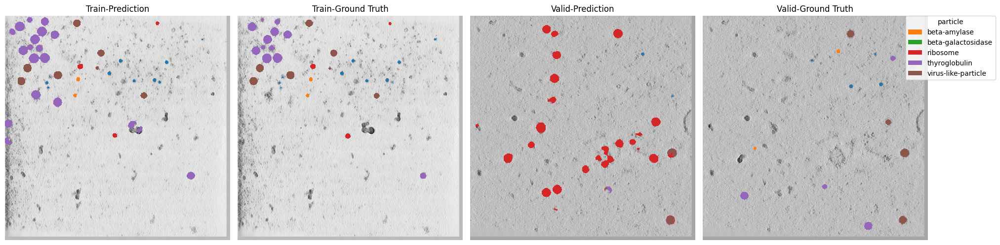

Train-Epoch: 58, Loss: 0.0032448473111245497: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 58, Loss: 2.032837459043817: 100%|██████████| 3680/3680 [02:37<00:00, 23.33it/s]  


EPOCH: 58, TRAIN_SCORE: 0.3601072016540746, TRAIN_SCORE_LIST: [0.36712733847736995, 0.38483918998919825, 0.3736593755038716, 0.3561207488527671, 0.3187893554471661]


Valid-Epoch: 58, Loss: 2.226814965003158: 100%|██████████| 368/368 [00:16<00:00, 22.58it/s]   


EPOCH: 58, VALID_SCORE: 0.3659903812561893, VALID_SCORE_LIST: [0.4095308411624018, 0.3224499213499768]


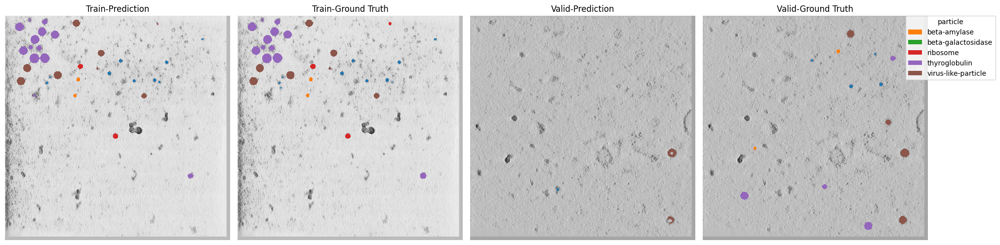

Train-Epoch: 59, Loss: 0.0034113357505386535: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 59, Loss: 1.5183397891670551: 100%|██████████| 3680/3680 [02:38<00:00, 23.27it/s]  


EPOCH: 59, TRAIN_SCORE: 0.22948570266122675, TRAIN_SCORE_LIST: [0.22295396905300438, 0.2464489822560618, 0.23588789946529104, 0.22542848391402617, 0.21670917861775046]


Valid-Epoch: 59, Loss: 1.3974241886821444: 100%|██████████| 368/368 [00:16<00:00, 21.76it/s]  


EPOCH: 59, VALID_SCORE: 0.33354859909054047, VALID_SCORE_LIST: [0.37863269795395926, 0.28846450022712167]


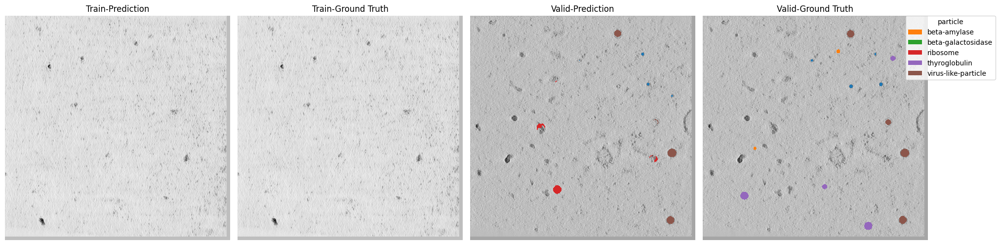

Train-Epoch: 60, Loss: 0.003102088093620968: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 60, Loss: 2.012413367737045: 100%|██████████| 3680/3680 [02:38<00:00, 23.27it/s]   


EPOCH: 60, TRAIN_SCORE: 0.3981320155582317, TRAIN_SCORE_LIST: [0.415267550178282, 0.39476548408455153, 0.3976054727029454, 0.38430732952078467, 0.398714241304595]


Valid-Epoch: 60, Loss: 2.046946857092753: 100%|██████████| 368/368 [00:16<00:00, 22.60it/s]   


EPOCH: 60, VALID_SCORE: 0.3529811538099369, VALID_SCORE_LIST: [0.4183970833912607, 0.28756522422861314]


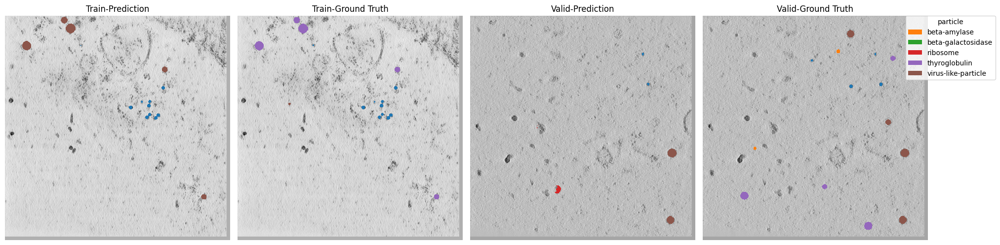

Train-Epoch: 61, Loss: 0.003105285253601007: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 61, Loss: 0.560377831196563: 100%|██████████| 3680/3680 [02:38<00:00, 23.24it/s]   


EPOCH: 61, TRAIN_SCORE: 0.07211356594141025, TRAIN_SCORE_LIST: [0.06410196010752196, 0.077981604081145, 0.09362671394185075, 0.06814636772503015, 0.056711183851503415]


Valid-Epoch: 61, Loss: 1.5449287016504911: 100%|██████████| 368/368 [00:16<00:00, 21.92it/s]  


EPOCH: 61, VALID_SCORE: 0.1416820536866324, VALID_SCORE_LIST: [0.15857736773300377, 0.12478673964026099]


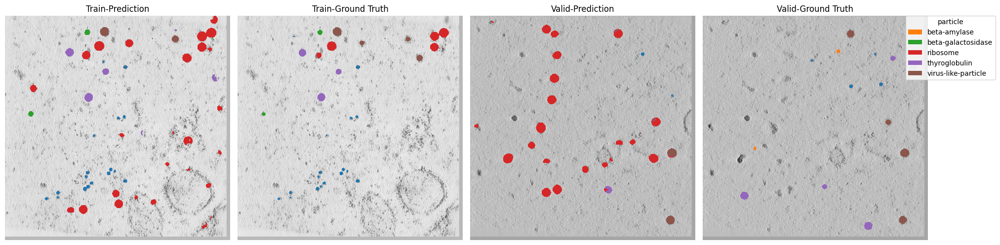

Train-Epoch: 62, Loss: 0.002906221273081863: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 62, Loss: 1.564905195952552: 100%|██████████| 3680/3680 [02:38<00:00, 23.25it/s]    


EPOCH: 62, TRAIN_SCORE: 0.23345250365151085, TRAIN_SCORE_LIST: [0.21853479892363356, 0.23043032480140133, 0.2609950789229083, 0.22223142406088928, 0.23507089154872185]


Valid-Epoch: 62, Loss: 1.4346401411750953: 100%|██████████| 368/368 [00:16<00:00, 22.46it/s]  


EPOCH: 62, VALID_SCORE: 0.3383670462376438, VALID_SCORE_LIST: [0.39056693302811774, 0.28616715944716986]


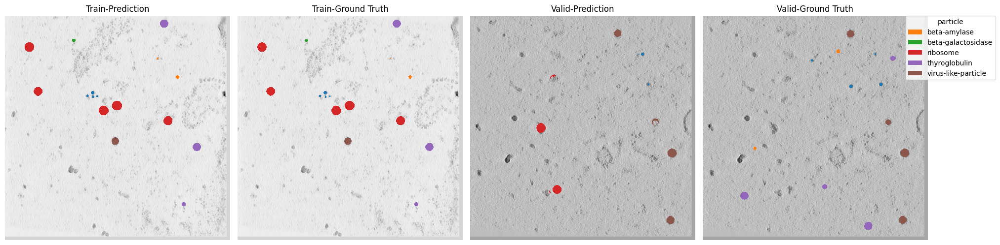

Train-nshuffle-Epoch: 63, Loss: 0.59537517086951: 100%|██████████| 3680/3680 [02:38<00:00, 23.29it/s]    


EPOCH: 63, TRAIN_SCORE: 0.11377583831600639, TRAIN_SCORE_LIST: [0.1037165195680284, 0.11848122342673917, 0.14373734263205434, 0.10489518066668958, 0.09804892528652047]


Valid-Epoch: 63, Loss: 1.562210729985722: 100%|██████████| 368/368 [00:16<00:00, 22.55it/s]   


EPOCH: 63, VALID_SCORE: 0.25386409145754807, VALID_SCORE_LIST: [0.279446076549888, 0.22828210636520815]


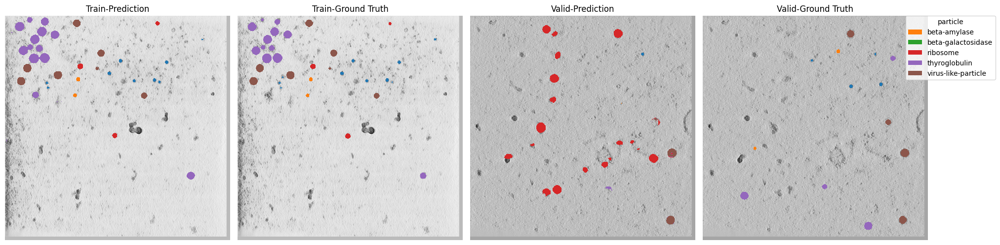

Train-Epoch: 64, Loss: 0.003466509272086272: 100%|██████████| 460/460 [04:10<00:00,  1.83it/s] 
Train-nshuffle-Epoch: 64, Loss: 2.081721083318875: 100%|██████████| 3680/3680 [02:38<00:00, 23.15it/s]  


EPOCH: 64, TRAIN_SCORE: 0.3883290658439146, TRAIN_SCORE_LIST: [0.3905156753694349, 0.40567309606832513, 0.3884851039986296, 0.3799891781054246, 0.3769822756777585]


Valid-Epoch: 64, Loss: 2.0212300838059183: 100%|██████████| 368/368 [00:16<00:00, 21.99it/s] 


EPOCH: 64, VALID_SCORE: 0.2920398063483827, VALID_SCORE_LIST: [0.3040280150414278, 0.28005159765533766]


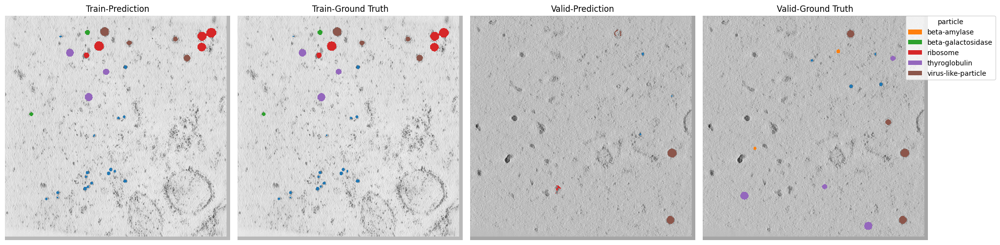

Train-Epoch: 65, Loss: 0.0030945514281958586: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 65, Loss: 1.9991963351594508: 100%|██████████| 3680/3680 [02:38<00:00, 23.25it/s] 


EPOCH: 65, TRAIN_SCORE: 0.3996007755086964, TRAIN_SCORE_LIST: [0.40998113164585465, 0.4151347737917896, 0.3861867580716642, 0.3859452873680472, 0.4007559266661262]


Valid-Epoch: 65, Loss: 2.3223195506793646: 100%|██████████| 368/368 [00:16<00:00, 21.90it/s]  


EPOCH: 65, VALID_SCORE: 0.35938214206278885, VALID_SCORE_LIST: [0.42838689571635563, 0.2903773884092221]


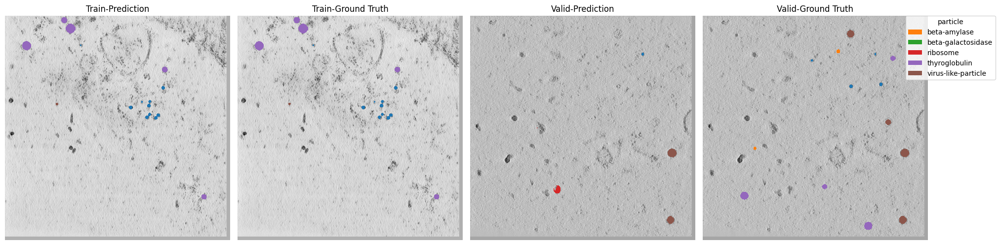

Train-Epoch: 66, Loss: 0.0028544494102116795: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 66, Loss: 0.4733592827521537: 100%|██████████| 3680/3680 [02:38<00:00, 23.21it/s]  


EPOCH: 66, TRAIN_SCORE: 0.0919330576676053, TRAIN_SCORE_LIST: [0.08230461550113745, 0.09832316595868354, 0.11087568051501417, 0.08346612093290184, 0.0846957054302895]


Valid-Epoch: 66, Loss: 1.5333485657403265: 100%|██████████| 368/368 [00:16<00:00, 22.62it/s] 


EPOCH: 66, VALID_SCORE: 0.19377889635077028, VALID_SCORE_LIST: [0.20713632443072005, 0.18042146827082053]


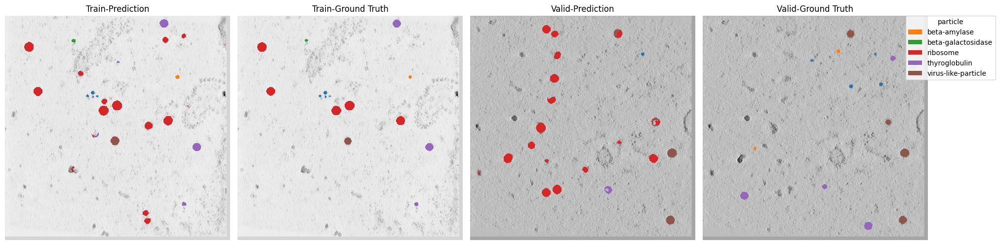

Train-Epoch: 67, Loss: 0.0028057631935276416: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 67, Loss: 0.9239374381434231: 100%|██████████| 3680/3680 [02:37<00:00, 23.39it/s] 


EPOCH: 67, TRAIN_SCORE: 0.0725610006285866, TRAIN_SCORE_LIST: [0.07555516515188507, 0.07913483567243997, 0.058838269223145036, 0.07149959194585127, 0.07777714114961164]


Valid-Epoch: 67, Loss: 2.7109596354579755: 100%|██████████| 368/368 [00:16<00:00, 22.34it/s]  


EPOCH: 67, VALID_SCORE: 0.07205449196596375, VALID_SCORE_LIST: [0.09411785630190692, 0.049991127630020595]


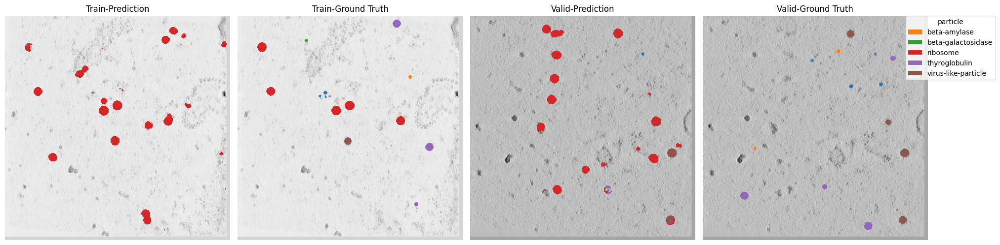

Train-Epoch: 68, Loss: 0.002740114417278876: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 68, Loss: 0.9123272894354384: 100%|██████████| 3680/3680 [02:38<00:00, 23.22it/s] 


EPOCH: 68, TRAIN_SCORE: 0.05178805413192674, TRAIN_SCORE_LIST: [0.0623510881848932, 0.05693151721889169, 0.04944507782422093, 0.05495263167050949, 0.03525995576111842]


Valid-Epoch: 68, Loss: 3.2904076568991214: 100%|██████████| 368/368 [00:16<00:00, 21.85it/s] 


EPOCH: 68, VALID_SCORE: 0.08172049423505043, VALID_SCORE_LIST: [0.09549650668663671, 0.06794448178346414]


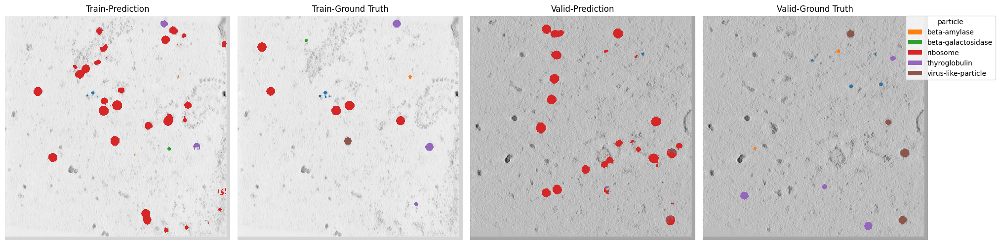

Train-Epoch: 69, Loss: 0.0025029018847777954: 100%|██████████| 460/460 [04:09<00:00,  1.84it/s]
Train-nshuffle-Epoch: 69, Loss: 2.0245449501426567: 100%|██████████| 3680/3680 [02:38<00:00, 23.28it/s] 


EPOCH: 69, TRAIN_SCORE: 0.3951561587399304, TRAIN_SCORE_LIST: [0.41687986690330553, 0.3868523390101375, 0.4009574050895765, 0.3732365156554462, 0.39785466704118605]


Valid-Epoch: 69, Loss: 2.5615290650369924: 100%|██████████| 368/368 [00:16<00:00, 22.69it/s]  


EPOCH: 69, VALID_SCORE: 0.33872095062466856, VALID_SCORE_LIST: [0.34570891930936665, 0.3317329819399705]


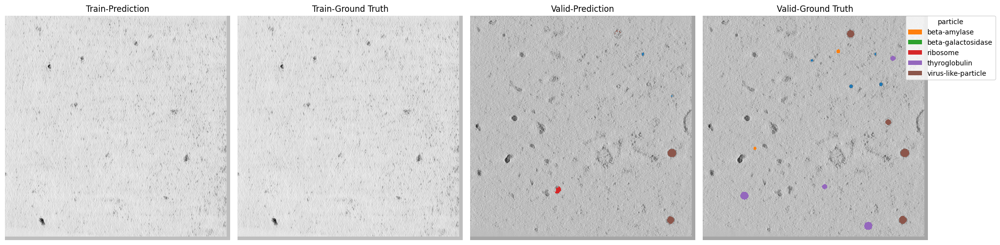

Train-Epoch: 70, Loss: 0.002760469341718936: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s] 
Train-nshuffle-Epoch: 70, Loss: 0.654043616652955: 100%|██████████| 3680/3680 [02:38<00:00, 23.21it/s]  


EPOCH: 70, TRAIN_SCORE: 0.0990756500974207, TRAIN_SCORE_LIST: [0.09190768441811563, 0.10388442691121523, 0.12781078139717936, 0.09922721866309267, 0.07254813909750056]


Valid-Epoch: 70, Loss: 1.9831546917347769: 100%|██████████| 368/368 [00:16<00:00, 21.78it/s]  


EPOCH: 70, VALID_SCORE: 0.20301122007342698, VALID_SCORE_LIST: [0.23414186794661246, 0.17188057220024153]


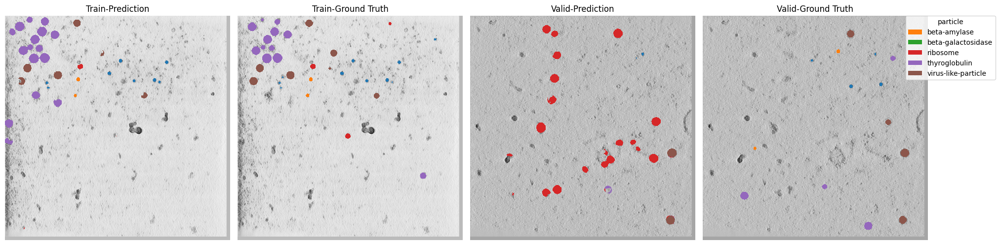

Train-Epoch: 71, Loss: 0.0027181962244313858: 100%|██████████| 460/460 [04:10<00:00,  1.84it/s]
Train-nshuffle-Epoch: 71, Loss: 0.6126746064017176:  91%|█████████▏| 3364/3680 [02:41<00:10, 31.48it/s]  

In [ ]:
best_model = None
best_score = 0

for epoch in range(100):
    train_loss = []
    train_nshuffle_loss = []
    valid_loss = []

    # train_original_tomogram = defaultdict(list)
    ##train_pred_tomogram = defaultdict(list)
    # train_gt_tomogram = defaultdict(list)

    train_nshuffle_original_tomogram = defaultdict(list)
    train_nshuffle_pred_tomogram = defaultdict(list)
    train_nshuffle_gt_tomogram = defaultdict(list)

    valid_original_tomogram = defaultdict(list)
    valid_pred_tomogram = defaultdict(list)
    valid_gt_tomogram = defaultdict(list)

    model.train()
    tq = tqdm(range(len(train_loader) * normalized_tomogram.shape[0] // batch_size))
    for data in train_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"]
        segmentation_map = data["segmentation_map"]

        tomogram = tomogram.reshape(1, -1, tomogram.shape[-2], tomogram.shape[-1])
        segmentation_map = segmentation_map.reshape(
            1, -1, segmentation_map.shape[-2], segmentation_map.shape[-1]
        )

        random_index = torch.randperm(tomogram.shape[1])

        for i in range(0, tomogram.shape[1], batch_size):
            optimizer.zero_grad()
            input_ = (
                tomogram[:, random_index[i : i + batch_size]].to("cuda").transpose(0, 1)
            )
            gt = (
                segmentation_map[:, random_index[i : i + batch_size]]
                .to("cuda")
                .long()
                .squeeze()
            )
            # print(input_.shape, gt.shape)

            input_ = padf(input_)
            gt = padf(gt)
            # input_, gt = aug(input_, gt)
            output = model(input_)
            loss = seg_loss(output, gt)
            loss.backward()
            optimizer.step()
            scheduler.step()

            train_loss.append(loss.item())
            tq.set_description(f"Train-Epoch: {epoch}, Loss: {np.mean(train_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            # train_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            # train_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    train_exp_name = exp_name

    ######################################## train-nshuffle #########################################
    model.eval()
    tq = tqdm(range(len(train_nshuffle_loader) * normalized_tomogram.shape[0]))
    for data in train_nshuffle_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        train_nshuffle_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            train_nshuffle_loss.append(loss.item())
            tq.set_description(
                f"Train-nshuffle-Epoch: {epoch}, Loss: {np.mean(train_nshuffle_loss)}"
            )
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            train_nshuffle_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            train_nshuffle_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()

    train_score_, train_score_list = visualize_epoch_results(
        train_nshuffle_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )
    print(
        f"EPOCH: {epoch}, TRAIN_SCORE: {train_score_}, TRAIN_SCORE_LIST: {train_score_list}"
    )

    ############################################# valid #############################################

    model.eval()
    tq = tqdm(range(len(valid_loader) * normalized_tomogram.shape[0]))
    for data in valid_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        valid_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            valid_loss.append(loss.item())
            tq.set_description(f"Valid-Epoch: {epoch}, Loss: {np.mean(valid_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            valid_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            valid_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    valid_exp_name = exp_name

    valid_score_, valid_score_list = visualize_epoch_results(
        valid_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )

    print(
        f"EPOCH: {epoch}, VALID_SCORE: {valid_score_}, VALID_SCORE_LIST: {valid_score_list}"
    )
    if valid_score_ > best_score:
        best_score = valid_score_
        best_model = model
        torch.save(model.state_dict(), f"best_model.pth")

    # 描画
    index = 30
    plt.figure(figsize=(20, 5))

    # Train-Pred-Plot
    ax = plt.subplot(1, 4, 1)
    pred = train_nshuffle_pred_tomogram[train_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred,
        "Train-Prediction",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Train-GT-Plot
    ax = plt.subplot(1, 4, 2)
    gt = train_nshuffle_gt_tomogram[train_exp_name][index][0]
    plot_with_colormap(
        gt,
        "Train-Ground Truth",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Valid-Pred-Plot
    ax = plt.subplot(1, 4, 3)
    pred = valid_pred_tomogram[valid_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred, "Valid-Prediction", valid_original_tomogram[valid_exp_name][index]
    )

    # Valid-GT-Plot
    ax = plt.subplot(1, 4, 4)
    gt = valid_gt_tomogram[valid_exp_name][index][0]
    plot_with_colormap(
        gt, "Valid-Ground Truth", valid_original_tomogram[valid_exp_name][index]
    )

    # 凡例を追加
    legend_elements = [
        Patch(facecolor=colors[i], label=CFG.particles_name[i])
        for i in range(1, num_classes)
    ]
    plt.legend(
        handles=legend_elements,
        loc="upper right",
        title="particle",
        bbox_to_anchor=(1.3, 1),  # 凡例を右上に配置
        borderaxespad=0,
    )

    plt.tight_layout()
    plt.show()